In [15]:
%matplotlib inline
%pylab inline


from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import tensorflow as tf
import sys
import argparse
import importlib
import facenet
import os
import numpy as np
import h5py
import math
from scipy import misc

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
tf.logging.set_verbosity(tf.logging.ERROR)

import matplotlib
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
np.random.seed(None)
pylab.rcParams['figure.figsize'] = (10, 6)


Populating the interactive namespace from numpy and matplotlib


/home/aprml6/.local/lib/python2.7/site-packages/IPython/core/magics/pylab.py:161: UserWarning: pylab import has clobbered these variables: ['f', 'mean', 'std']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


In [2]:
img_mean = np.array([134.10714722, 102.52040863, 87.15436554])
img_stddev = np.sqrt(np.array([3941.30175781, 2856.94287109, 2519.35791016]))

latentVarSize = 100
vae_def = importlib.import_module('generative.models.dfc_vae')
vae = vae_def.Vae(latentVarSize)
gen_image_size = vae.get_image_size()

In [3]:
with tf.Graph().as_default():

    images = tf.placeholder(tf.float32, shape=(None, gen_image_size,gen_image_size,3), name='input')

    # Normalize
    images_norm = (images-img_mean) / img_stddev

    # Resize to appropriate size for the encoder 
    images_norm_resize = tf.image.resize_images(images_norm, (gen_image_size,gen_image_size))

    # Create encoder network
    mean, log_variance = vae.encoder(images_norm_resize, True)

    epsilon = tf.random_normal((tf.shape(mean)[0], latentVarSize))
    std = tf.exp(log_variance/2)
    latent_var = mean + epsilon * std

    # Create decoder
    reconstructed_norm = vae.decoder(latent_var, False)

    # Un-normalize
    reconstructed = (reconstructed_norm*img_stddev) + img_mean

    # Create a saver
    saver = tf.train.Saver(tf.trainable_variables(), max_to_keep=3)

    # Start running operations on the Graph
    gpu_memory_fraction = 1.0
    gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=gpu_memory_fraction)
    sess = tf.Session(config=tf.ConfigProto(gpu_options=gpu_options, log_device_placement=False))
    sess.run(tf.global_variables_initializer())
    sess.run(tf.local_variables_initializer())
    coord = tf.train.Coordinator()
    tf.train.start_queue_runners(coord=coord, sess=sess)

# Generate original and target Imgaes and take initial genes

In [4]:
with sess.as_default():
    
    # Load checkpoint
    vae_checkpoint = os.path.expanduser('/home/aprml6/kush/ai/facenet/vae/model.ckpt-50000')
    print('Restoring VAE checkpoint: %s' % vae_checkpoint)
    saver.restore(sess, vae_checkpoint)
    
    # Load attribute file
    filename = os.path.expanduser('/home/aprml6/kush/ai/facenet/vae/attribute_vectors.h5')
    with h5py.File(filename,'r') as f:
        latent_vars = np.array(f.get('latent_vars'))
        attributes = np.array(f.get('attributes'))
        #fields = np.array(f.get('fields'))
        attribute_vectors = np.array(f.get('attribute_vectors'))

    attribute_index = 31
    image_indices = [8]
    nrof_images = len(image_indices)
    nrof_interp_steps = 2
    sweep_latent_var = np.zeros((nrof_interp_steps * nrof_images, latentVarSize), np.float32)
    for j in range(nrof_images):
        image_index = image_indices[j]
        idx = np.argwhere(attributes[:, attribute_index] == -1)[image_index, 0]
        initialGenes = latent_vars[idx,:]
        for i in range(nrof_interp_steps):
            sweep_latent_var[i+nrof_interp_steps*j,:] = latent_vars[idx,:] + 5.0*i/nrof_interp_steps*attribute_vectors[attribute_index,:]
            print (sweep_latent_var.shape)
    recon = sess.run(reconstructed, feed_dict={latent_var:sweep_latent_var})

    for i in range(recon.shape[0]):           
        img = facenet.put_images_on_grid(recon[i : i + 1], shape=(1, 1))
        image_filename = os.path.expanduser('/home/aprml6/kush/ai/facenet/vae/add_smile') + str(i) + '.png'
        print('Writing generated image to %s' % image_filename)
        misc.imsave(image_filename, img)

Restoring VAE checkpoint: /home/aprml6/kush/ai/facenet/vae/model.ckpt-50000
(2, 100)
(2, 100)
Writing generated image to /home/aprml6/kush/ai/facenet/vae/add_smile0.png
Writing generated image to /home/aprml6/kush/ai/facenet/vae/add_smile1.png


# Original Image and Target Image

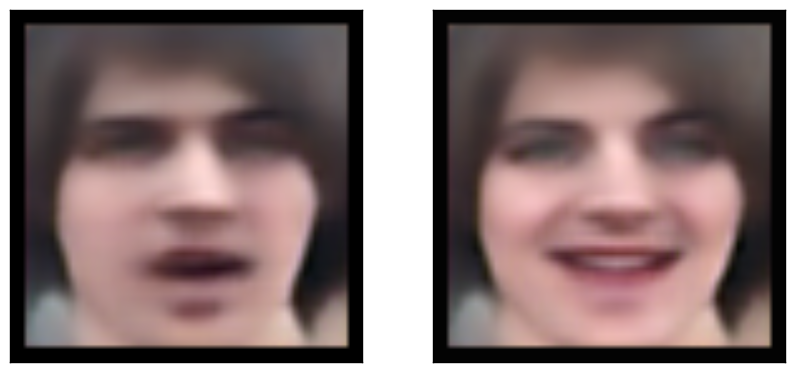

In [16]:
originalImage = misc.imread('/home/aprml6/kush/ai/facenet/vae/original.png')
plt.subplot(1, 2, 1)
plt.gca().xaxis.set_visible(False)
plt.gca().yaxis.set_visible(False)
plt.imshow(originalImage)

targetImage = misc.imread('/home/aprml6/kush/ai/facenet/vae/target.png')
plt.subplot(1, 2, 2)
plt.gca().xaxis.set_visible(False)
plt.gca().yaxis.set_visible(False)
plt.imshow(targetImage)

In [6]:
attribute_index = 31
image_index = 10
nrof_images = len(image_indices)
nrof_interp_steps = 1

# Genetic learning helpers

In [7]:
bestGenes = initialGenes

In [8]:
def evaluateFitness(solution):
    return np.log(np.sum(np.abs(solution - targetImage)))

def generateTwoIndices(n):
    
    """
        Generates two random integers in [0, n) such 
        that first < second
        
    """
    
    first, second = 0, 0
    while first == second:
        first  = int(np.random.uniform() * n)
        second = int(np.random.uniform() * n)
    
    if first > second:
        first, second = second, first

    return first, second


In [9]:
# Load attribute file
filename = os.path.expanduser('/home/aprml6/kush/ai/facenet/vae/attribute_vectors.h5')
with h5py.File(filename,'r') as f:
    latent_vars = np.array(f.get('latent_vars'))
    attributes = np.array(f.get('attributes'))
    attribute_vectors = np.array(f.get('attribute_vectors'))

In [10]:
def crossover(space1, space2):

    first, second = generateTwoIndices(len(space1))
    crossover = np.zeros_like(space1)   
    
    crossover[ : first] = space1[ : first]
    crossover[first : second] = space2[first : second]
    crossover[second : ] = space1[second : ]

    return crossover

def mutate(space):
    
    """
        Introduces mutation in a given solution
    """
    
    randIndex = int(np.random.uniform() * space.shape[0])
    space[randIndex] += (np.random.uniform(-1., 1.))
    return space 

In [13]:
def localSearch(latentSpace):
    
    newLatentSpace = [latentSpace]
    
    for i in range(latentSpace.shape[0]):
        tempLatentSpace = latentSpace
        tempLatentSpace[i] += np.random.uniform()
        newLatentSpace.append(tempLatentSpace)

    for i in range(latentSpace.shape[0]):
        tempLatentSpace = latentSpace
        tempLatentSpace[i] -= np.random.uniform()
        newLatentSpace.append(tempLatentSpace)

    newLatentSpace = np.array(newLatentSpace)

    with sess.as_default():
        # Load checkpoint
        vae_checkpoint = os.path.expanduser('/home/aprml6/kush/ai/facenet/vae/model.ckpt-50000')
        saver.restore(sess, vae_checkpoint)
        recon = sess.run(reconstructed, feed_dict={latent_var : newLatentSpace})

    scores = []
    
    # Select top solution based on evaluation function
    for i in range(newLatentSpace.shape[0]):
        img = facenet.put_images_on_grid(recon[i : i + 1], shape=(1, 1))
        misc.imsave('temp.png', img)
        img = misc.imread('temp.png')
        scores.append(evaluateFitness(img))
       
    scores = np.array(scores)
    return newLatentSpace[scores.argsort()[0]]

Iteration : 0 Best score : 14.0693594385


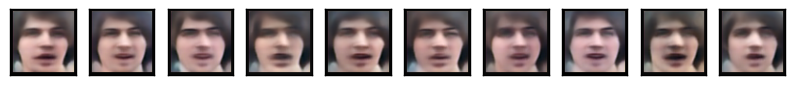

Iteration : 1 Best score : 13.9830898124


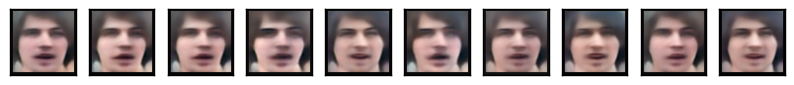

Iteration : 2 Best score : 13.8371644119


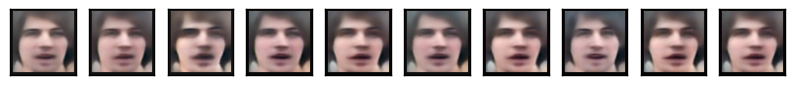

Iteration : 3 Best score : 13.8152795313


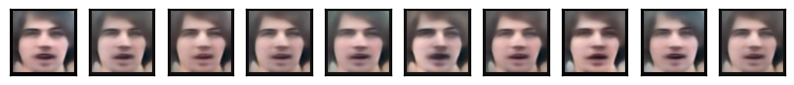

Iteration : 4 Best score : 13.6855134837


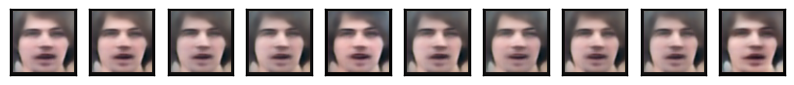

Iteration : 5 Best score : 13.6820705897


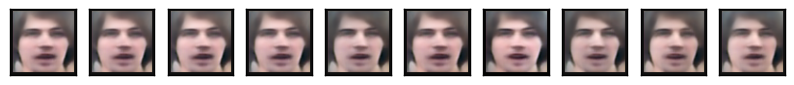

Iteration : 6 Best score : 13.6672297832


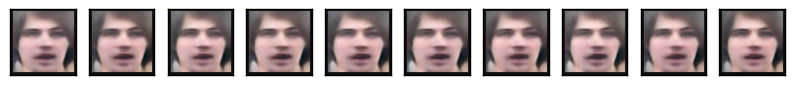

Iteration : 7 Best score : 13.6418616845


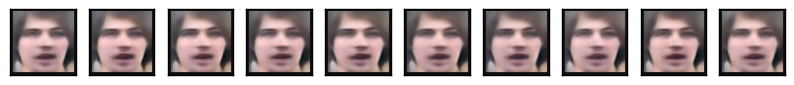

Iteration : 8 Best score : 13.6081972939


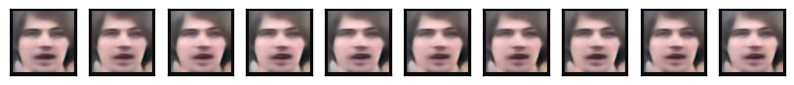

Iteration : 9 Best score : 13.579697081


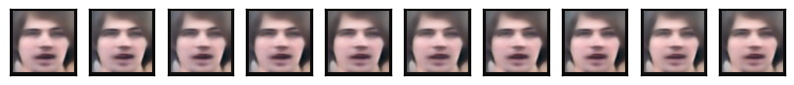

Iteration : 10 Best score : 13.5719959178


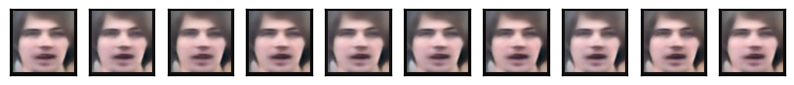

Iteration : 11 Best score : 13.5487781671


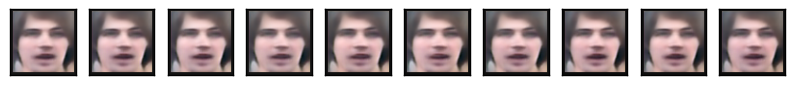

Iteration : 12 Best score : 13.5308851425


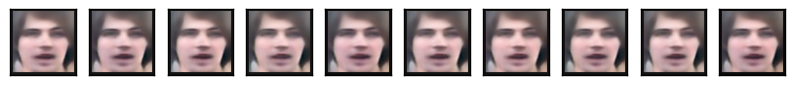

Iteration : 13 Best score : 13.4886897957


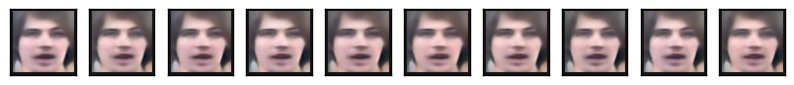

Iteration : 14 Best score : 13.4586241631


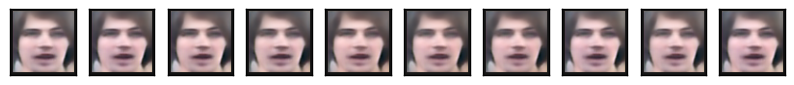

Iteration : 15 Best score : 13.4313763206


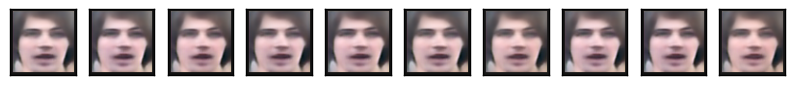

Iteration : 16 Best score : 13.4137366291


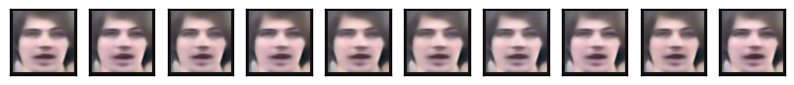

Iteration : 17 Best score : 13.3807057186


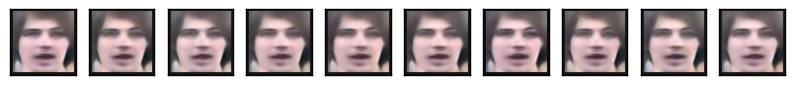

Iteration : 18 Best score : 13.3581735671


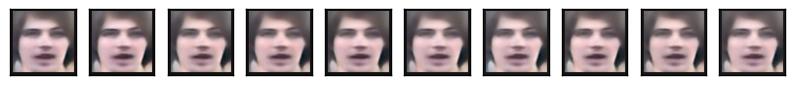

Iteration : 19 Best score : 13.3364322783


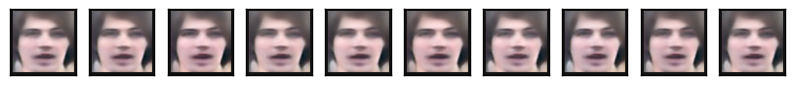

Iteration : 20 Best score : 13.3220941768


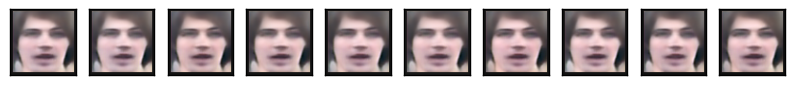

Iteration : 21 Best score : 13.3133357412


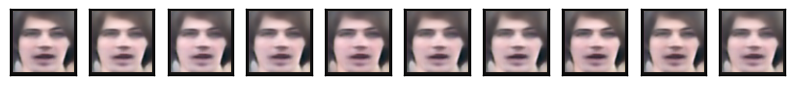

Iteration : 22 Best score : 13.2981586845


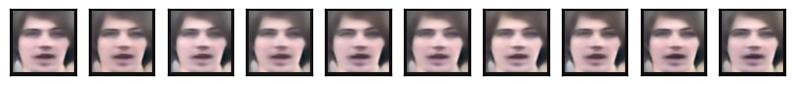

Iteration : 23 Best score : 13.2596370091


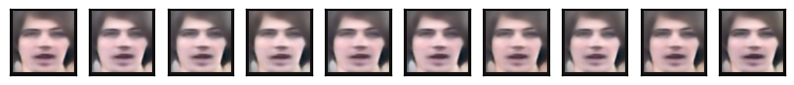

Iteration : 24 Best score : 13.2274510558


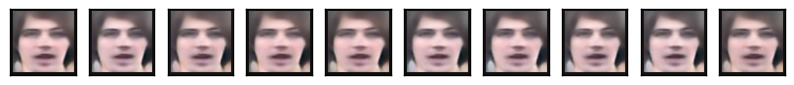

Iteration : 25 Best score : 13.2028570603


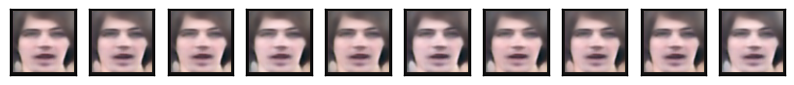

Iteration : 26 Best score : 13.1844701943


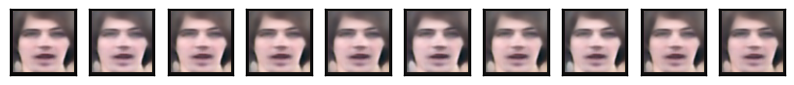

Iteration : 27 Best score : 13.1753068096


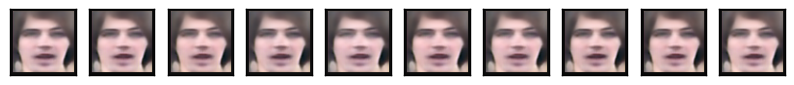

Iteration : 28 Best score : 13.1708715971


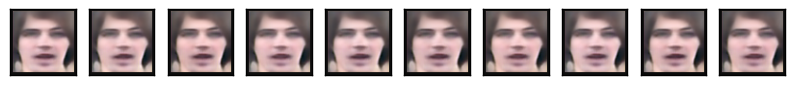

Iteration : 29 Best score : 13.1592139764


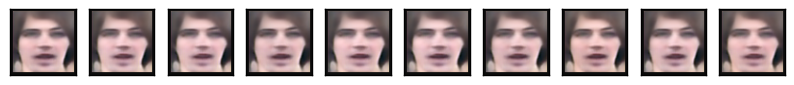

Iteration : 30 Best score : 13.1129714106


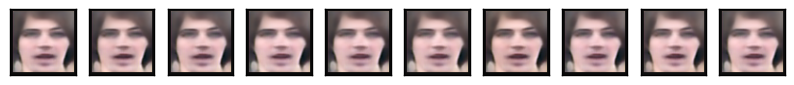

Iteration : 31 Best score : 13.1106571258


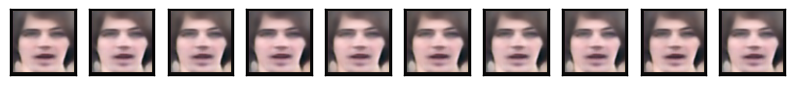

Iteration : 32 Best score : 13.0721747358


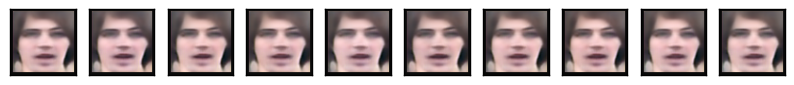

Iteration : 33 Best score : 13.0540609818


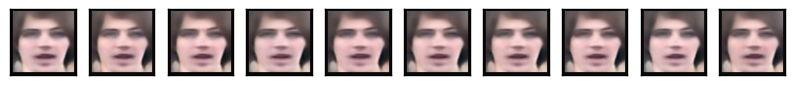

Iteration : 34 Best score : 13.042599131


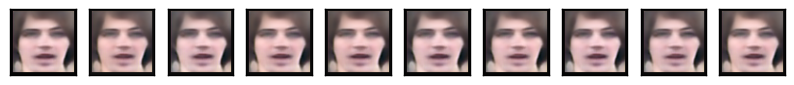

Iteration : 35 Best score : 13.0218886844


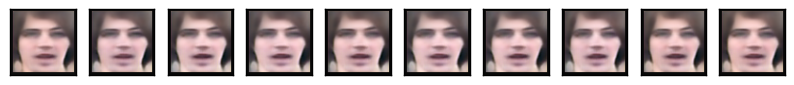

Iteration : 36 Best score : 13.0274195305


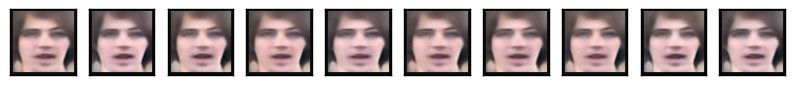

Iteration : 37 Best score : 13.0003742586


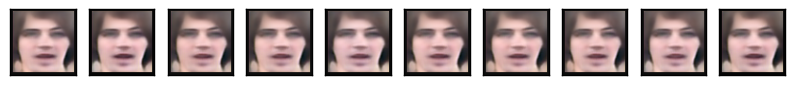

Iteration : 38 Best score : 12.9966300719


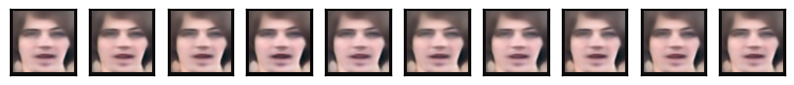

Iteration : 39 Best score : 12.9775225593


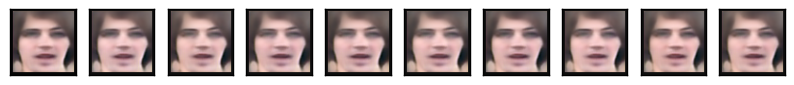

Iteration : 40 Best score : 12.9329882022


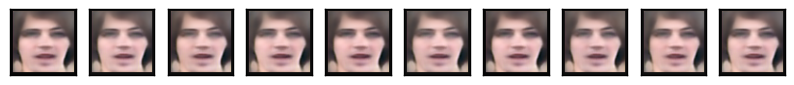

Iteration : 41 Best score : 12.9206608164


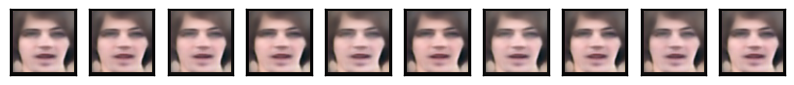

Iteration : 42 Best score : 12.9316797558


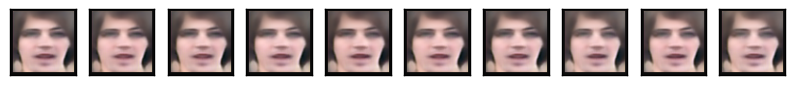

Iteration : 43 Best score : 12.9006038679


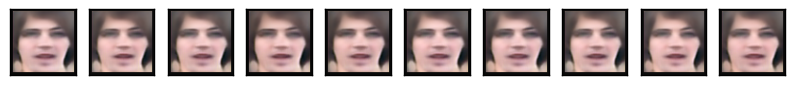

Iteration : 44 Best score : 12.884240697


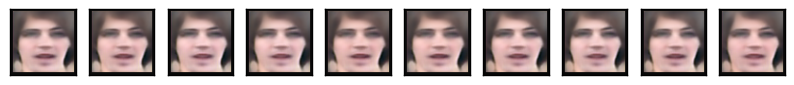

Iteration : 45 Best score : 12.8386016105


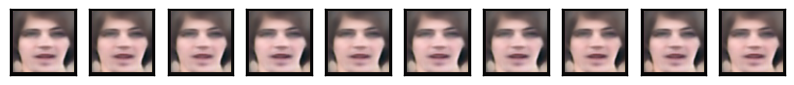

Iteration : 46 Best score : 12.849380737


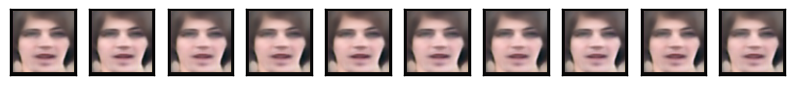

Iteration : 47 Best score : 12.8606972692


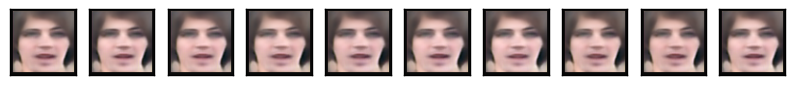

Iteration : 48 Best score : 12.8335793647


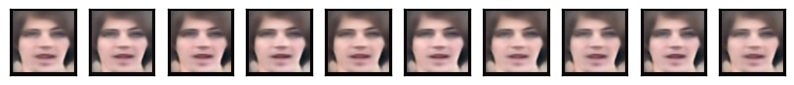

Iteration : 49 Best score : 12.8042468394


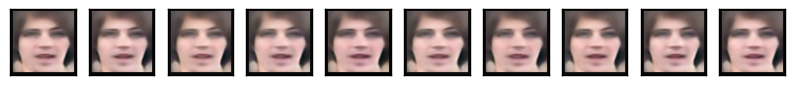

Iteration : 50 Best score : 12.8287222517


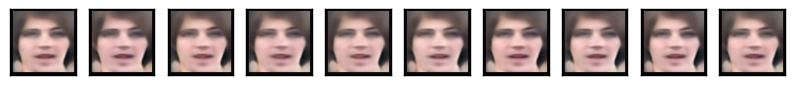

Iteration : 51 Best score : 12.8164766003


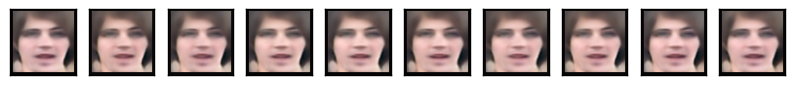

Iteration : 52 Best score : 12.7562583958


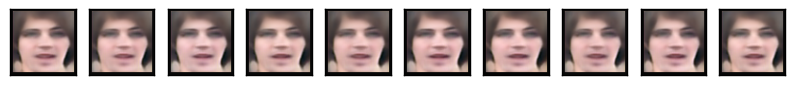

Iteration : 53 Best score : 12.7622740396


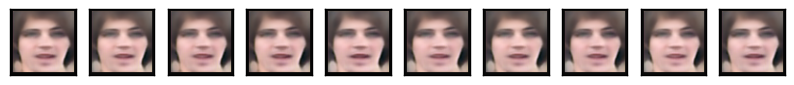

Iteration : 54 Best score : 12.7327430747


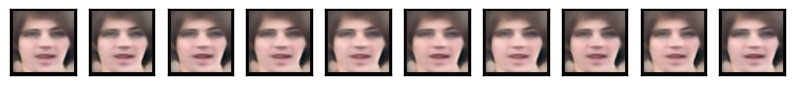

Iteration : 55 Best score : 12.6917496778


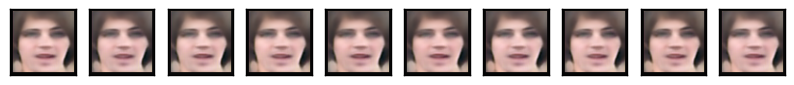

Iteration : 56 Best score : 12.7227600554


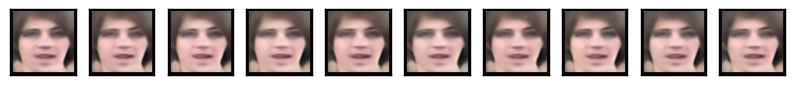

Iteration : 57 Best score : 12.7064872623


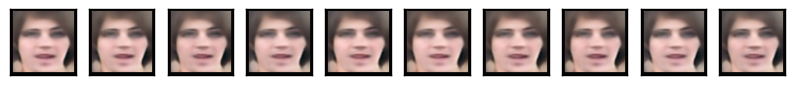

Iteration : 58 Best score : 12.673992856


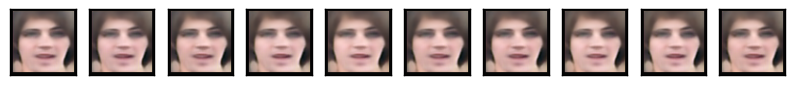

Iteration : 59 Best score : 12.6496649204


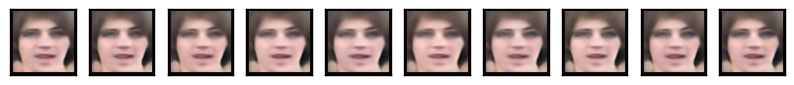

Iteration : 60 Best score : 12.6785357478


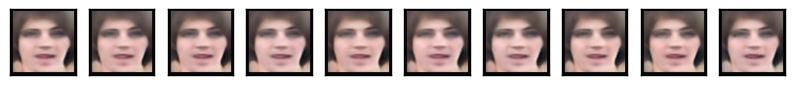

Iteration : 61 Best score : 12.6440436652


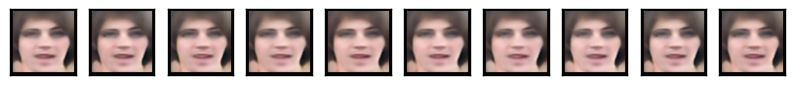

Iteration : 62 Best score : 12.6357391887


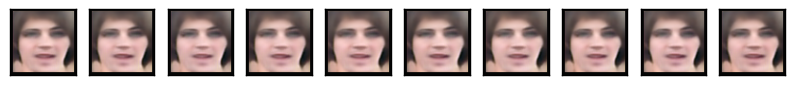

Iteration : 63 Best score : 12.641957027


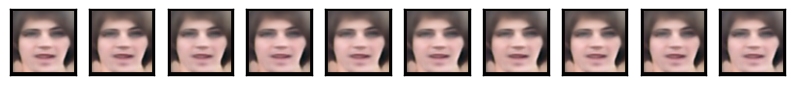

Iteration : 64 Best score : 12.6151777873


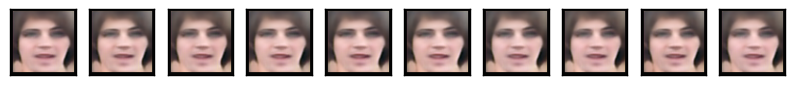

Iteration : 65 Best score : 12.633687298


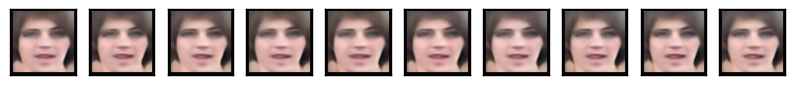

Iteration : 66 Best score : 12.6403357487


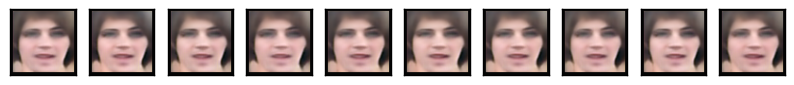

Iteration : 67 Best score : 12.6093453521


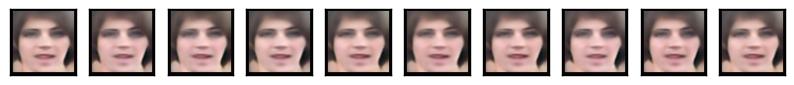

Iteration : 68 Best score : 12.6216332885


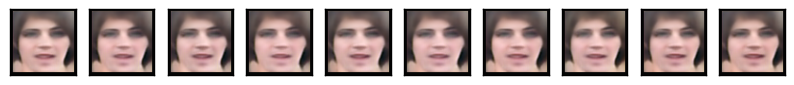

Iteration : 69 Best score : 12.6282965375


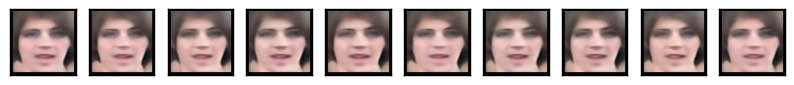

Iteration : 70 Best score : 12.6158949141


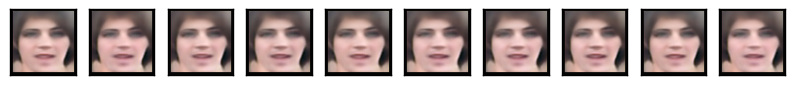

Iteration : 71 Best score : 12.621220722


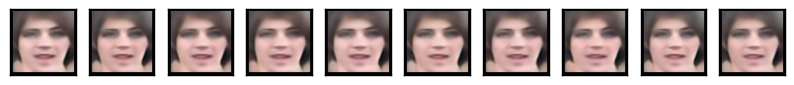

Iteration : 72 Best score : 12.5870572019


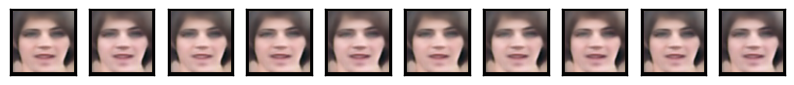

Iteration : 73 Best score : 12.590467323


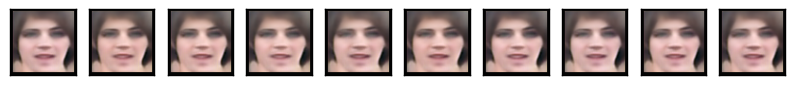

Iteration : 74 Best score : 12.5928033556


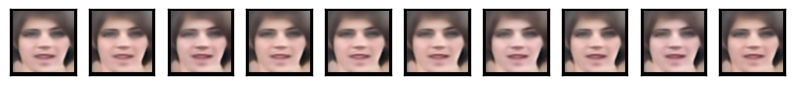

Iteration : 75 Best score : 12.6012752741


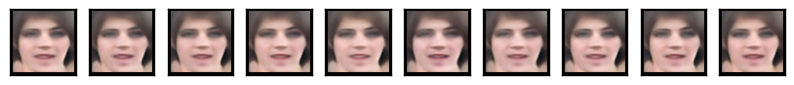

Iteration : 76 Best score : 12.6017500096


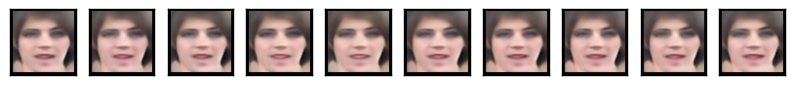

Iteration : 77 Best score : 12.6105973116


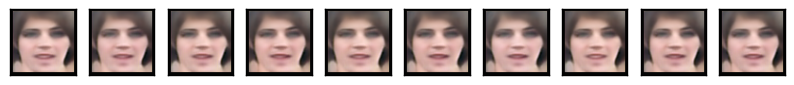

Iteration : 78 Best score : 12.5835051528


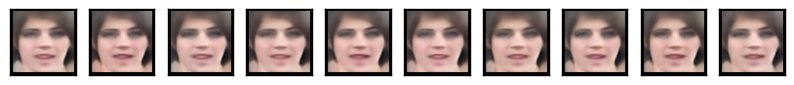

Iteration : 79 Best score : 12.5873201949


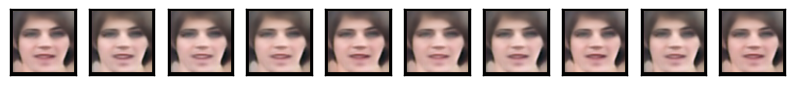

Iteration : 80 Best score : 12.586243877


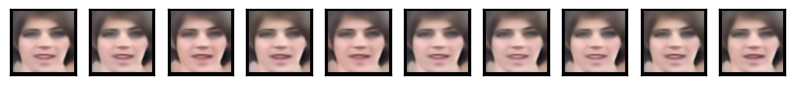

Iteration : 81 Best score : 12.5849815723


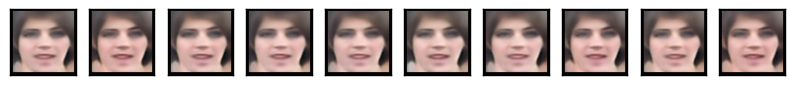

Iteration : 82 Best score : 12.5753646584


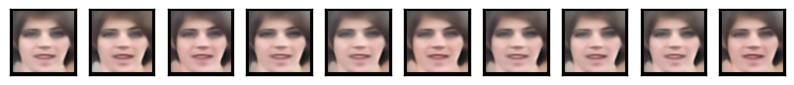

Iteration : 83 Best score : 12.5833817337


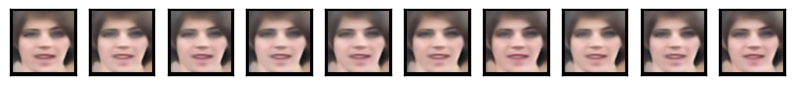

Iteration : 84 Best score : 12.5895545506


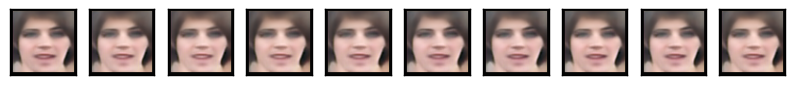

Iteration : 85 Best score : 12.5502543732


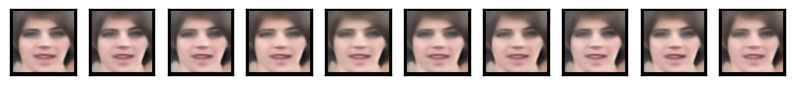

Iteration : 86 Best score : 12.5658532619


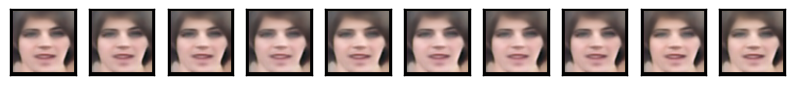

Iteration : 87 Best score : 12.5711878699


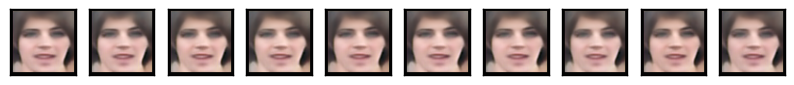

Iteration : 88 Best score : 12.576235221


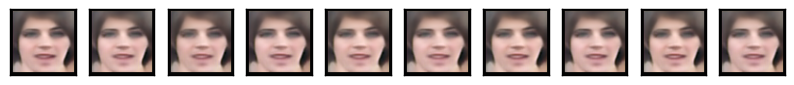

Iteration : 89 Best score : 12.5800539665


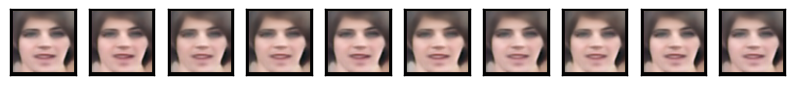

Iteration : 90 Best score : 12.5682683221


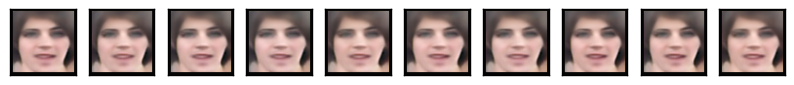

Iteration : 91 Best score : 12.5506689353


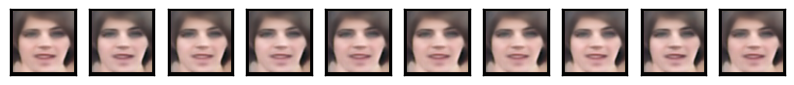

Iteration : 92 Best score : 12.5590718422


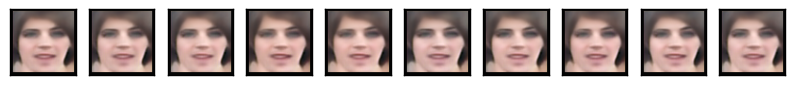

Iteration : 93 Best score : 12.5364872862


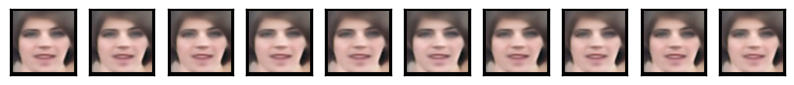

Iteration : 94 Best score : 12.5217115095


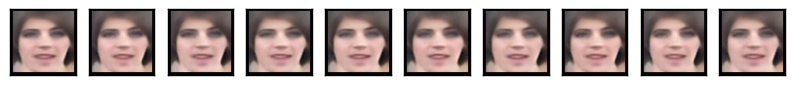

Iteration : 95 Best score : 12.5256493822


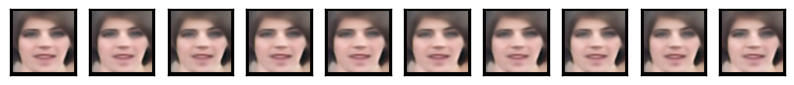

Iteration : 96 Best score : 12.5130645768


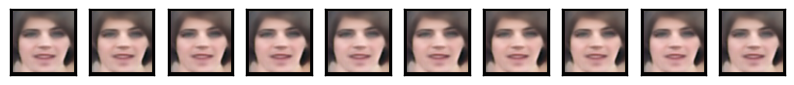

Iteration : 97 Best score : 12.5118941983


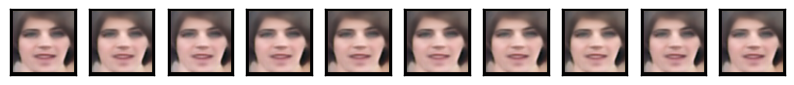

Iteration : 98 Best score : 12.4754621749


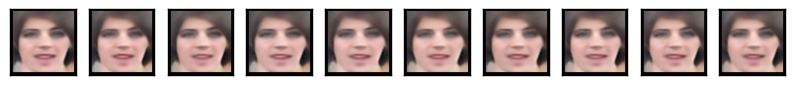

Iteration : 99 Best score : 12.493755968


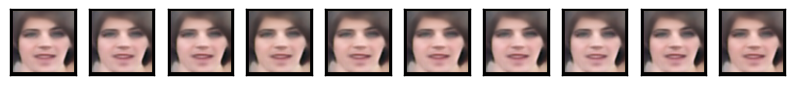

Iteration : 100 Best score : 12.5009599479


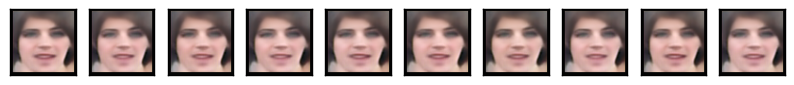

Iteration : 101 Best score : 12.4886466942


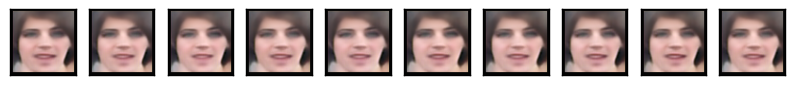

Iteration : 102 Best score : 12.4881264087


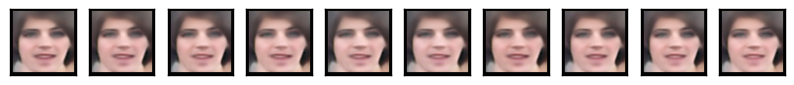

Iteration : 103 Best score : 12.4672900988


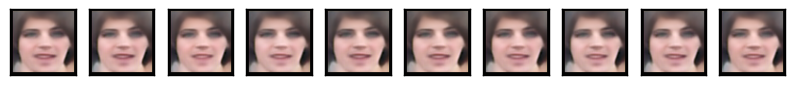

Iteration : 104 Best score : 12.4597221232


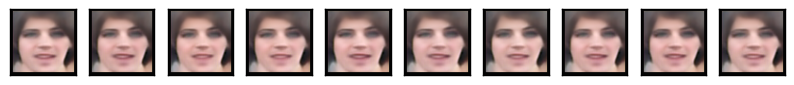

Iteration : 105 Best score : 12.4491443065


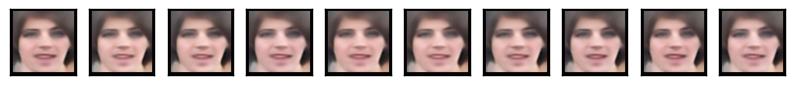

Iteration : 106 Best score : 12.443679103


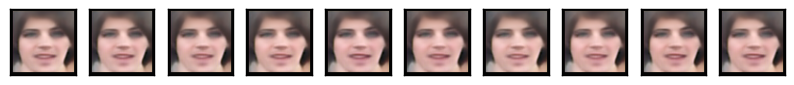

Iteration : 107 Best score : 12.3740586036


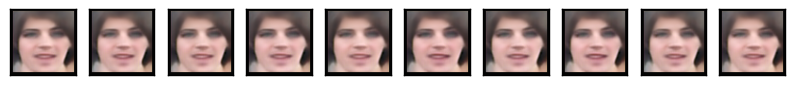

Iteration : 108 Best score : 12.3549063582


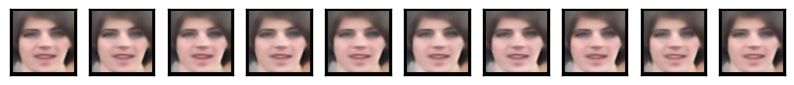

Iteration : 109 Best score : 12.411223291


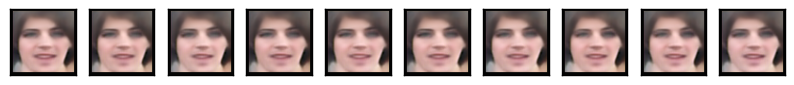

Iteration : 110 Best score : 12.3942064451


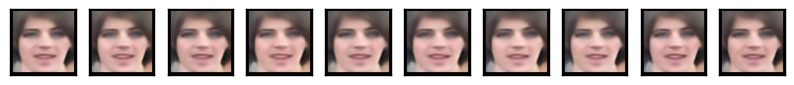

Iteration : 111 Best score : 12.4018737766


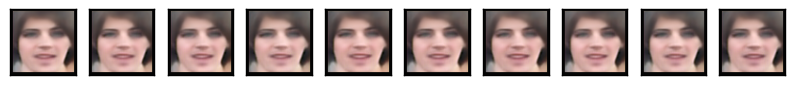

Iteration : 112 Best score : 12.4146871597


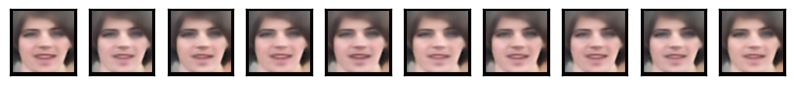

Iteration : 113 Best score : 12.3985961517


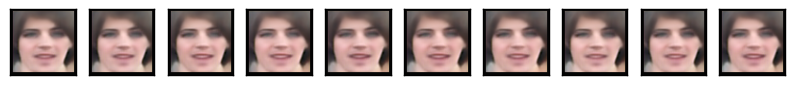

Iteration : 114 Best score : 12.3990538525


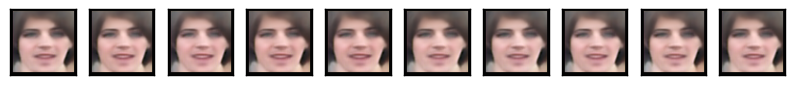

Iteration : 115 Best score : 12.4296241136


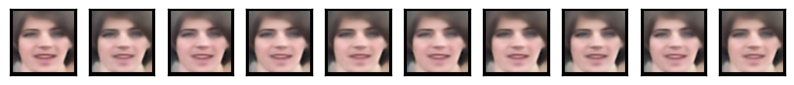

Iteration : 116 Best score : 12.4222922818


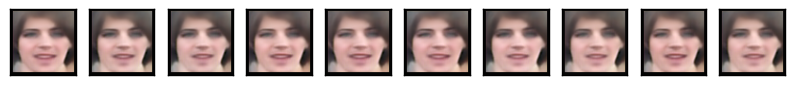

Iteration : 117 Best score : 12.4119967902


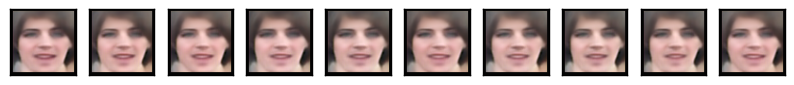

Iteration : 118 Best score : 12.3722986952


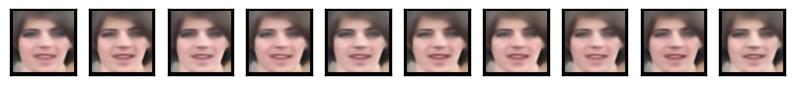

Iteration : 119 Best score : 12.4044889837


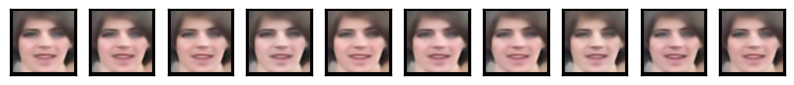

Iteration : 120 Best score : 12.4133875827


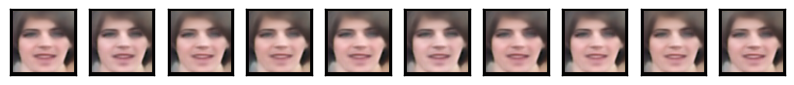

Iteration : 121 Best score : 12.4031309149


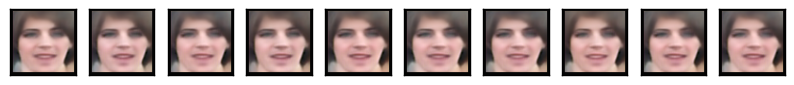

Iteration : 122 Best score : 12.394479814


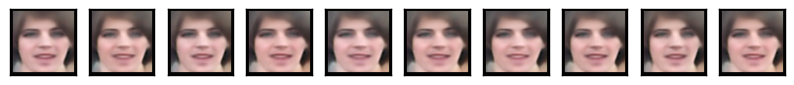

Iteration : 123 Best score : 12.3826527517


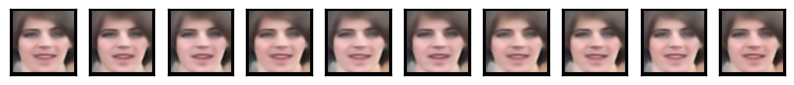

Iteration : 124 Best score : 12.37802395


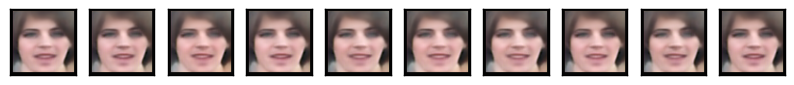

Iteration : 125 Best score : 12.3999439136


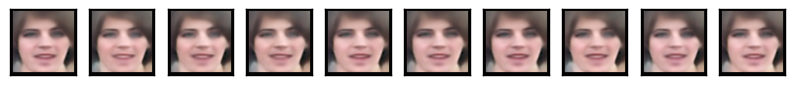

Iteration : 126 Best score : 12.3899471625


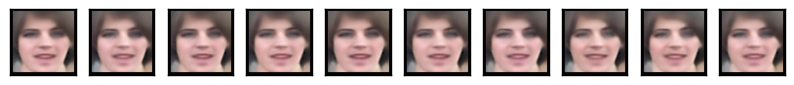

Iteration : 127 Best score : 12.4077964227


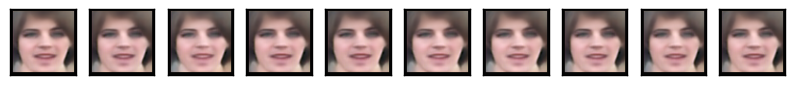

Iteration : 128 Best score : 12.4120781763


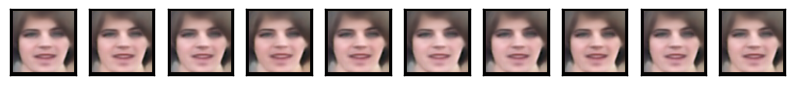

Iteration : 129 Best score : 12.4161228519


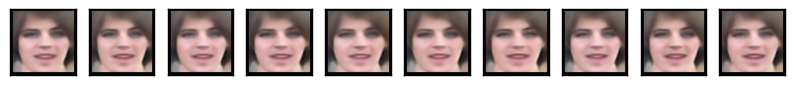

Iteration : 130 Best score : 12.3346549365


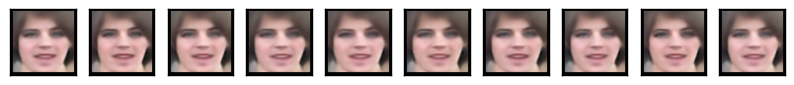

Iteration : 131 Best score : 12.3905003162


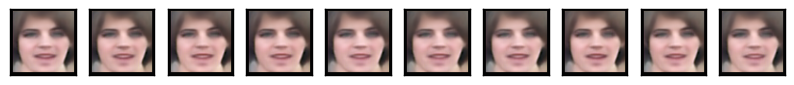

Iteration : 132 Best score : 12.3761950949


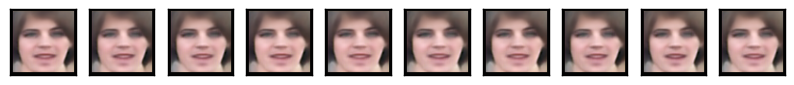

Iteration : 133 Best score : 12.37625836


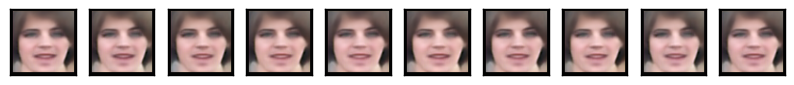

Iteration : 134 Best score : 12.364771538


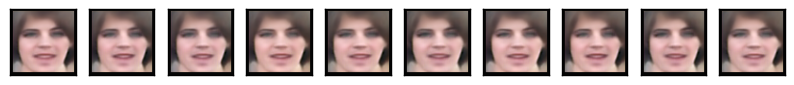

Iteration : 135 Best score : 12.3819358923


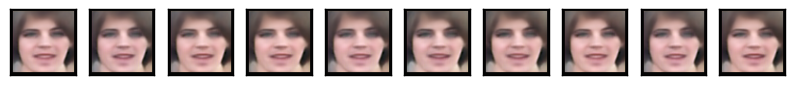

Iteration : 136 Best score : 12.3762625775


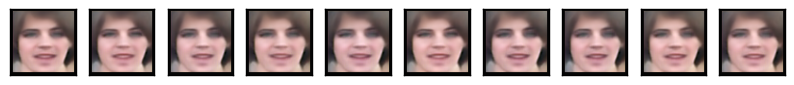

Iteration : 137 Best score : 12.3738683782


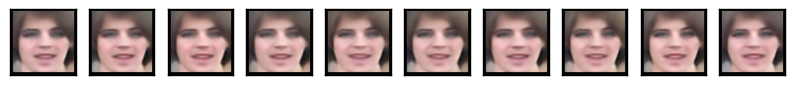

Iteration : 138 Best score : 12.3695978186


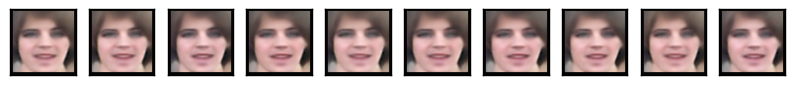

Iteration : 139 Best score : 12.3459824031


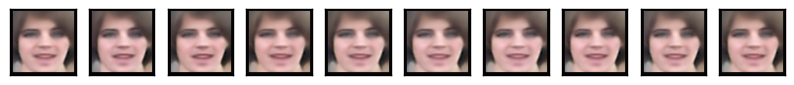

Iteration : 140 Best score : 12.3557332601


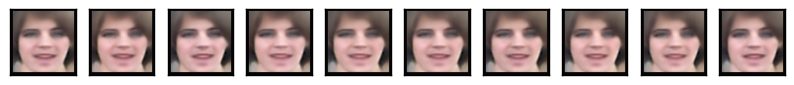

Iteration : 141 Best score : 12.368586825


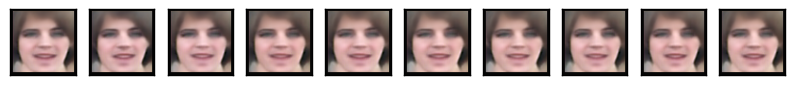

Iteration : 142 Best score : 12.3606118213


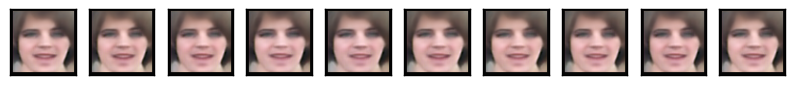

Iteration : 143 Best score : 12.3419138684


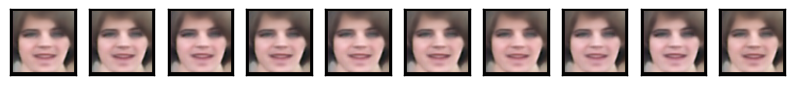

Iteration : 144 Best score : 12.3680809447


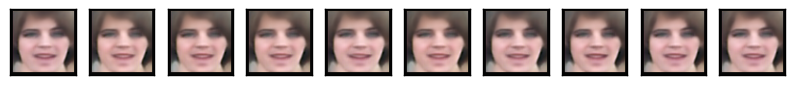

Iteration : 145 Best score : 12.3727474275


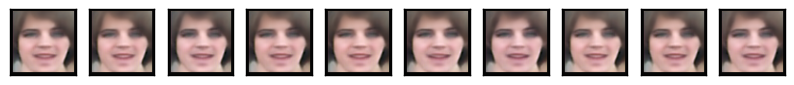

Iteration : 146 Best score : 12.3381967985


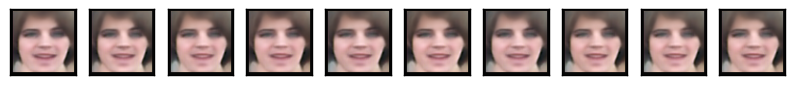

Iteration : 147 Best score : 12.3362101605


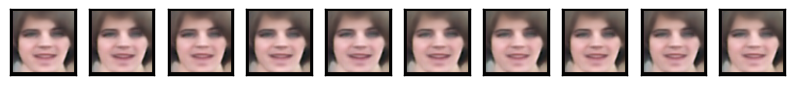

Iteration : 148 Best score : 12.3260222214


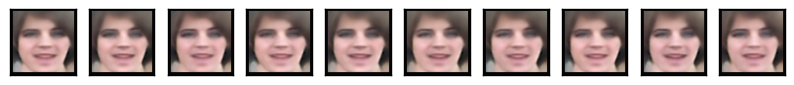

Iteration : 149 Best score : 12.3146534704


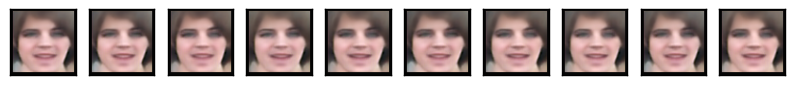

Iteration : 150 Best score : 12.3399258614


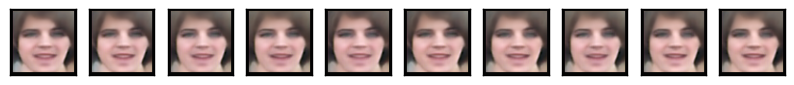

Iteration : 151 Best score : 12.3348088094


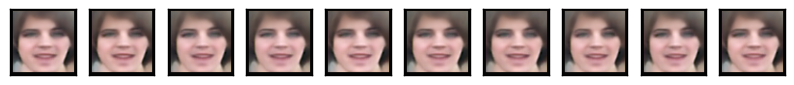

Iteration : 152 Best score : 12.338249371


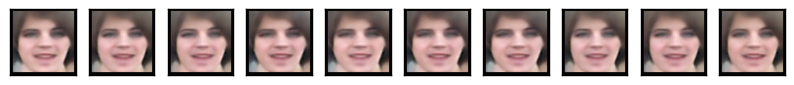

Iteration : 153 Best score : 12.302859008


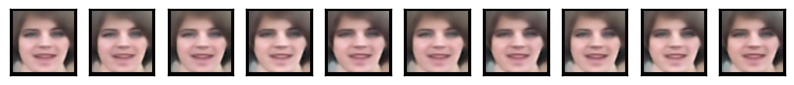

Iteration : 154 Best score : 12.3021915891


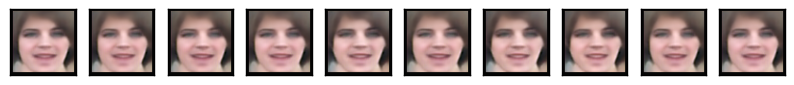

Iteration : 155 Best score : 12.307712749


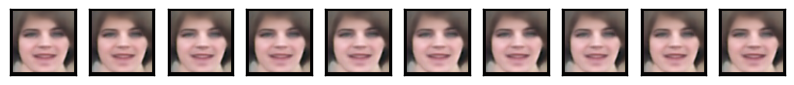

Iteration : 156 Best score : 12.2477183007


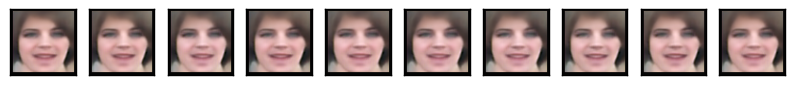

Iteration : 157 Best score : 12.2749268407


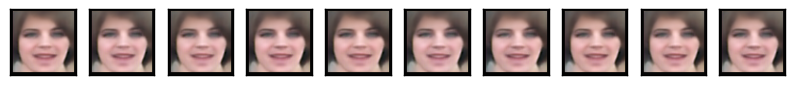

Iteration : 158 Best score : 12.2603856261


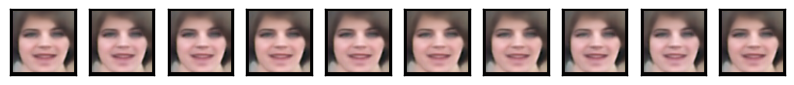

Iteration : 159 Best score : 12.2390769615


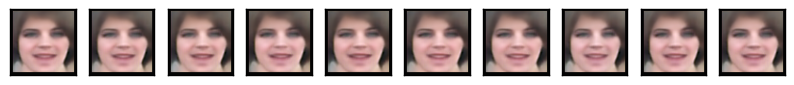

Iteration : 160 Best score : 12.2453318195


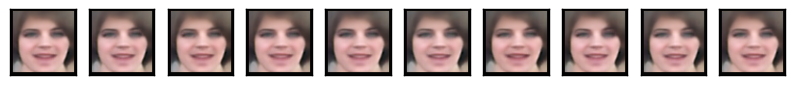

Iteration : 161 Best score : 12.2435321934


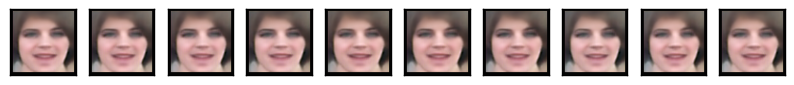

Iteration : 162 Best score : 12.2541292073


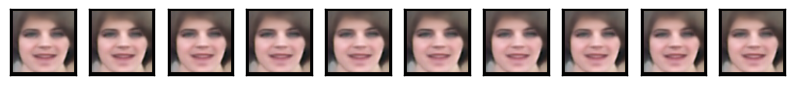

Iteration : 163 Best score : 12.2283134745


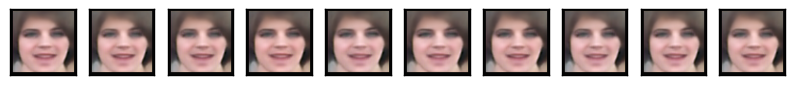

Iteration : 164 Best score : 12.21306812


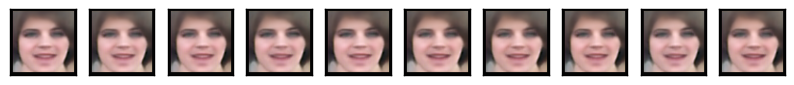

Iteration : 165 Best score : 12.2802938256


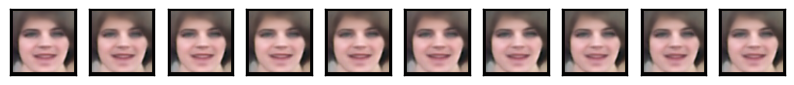

Iteration : 166 Best score : 12.272772891


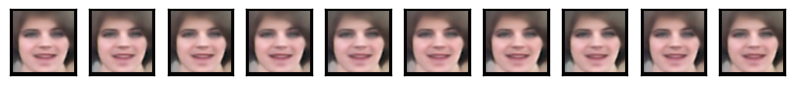

Iteration : 167 Best score : 12.2708064601


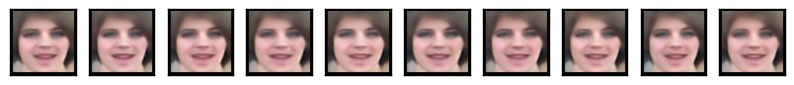

Iteration : 168 Best score : 12.2550056566


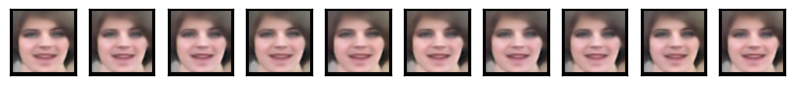

Iteration : 169 Best score : 12.2837649007


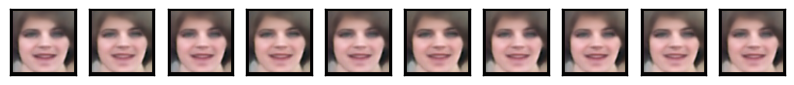

Iteration : 170 Best score : 12.2647329865


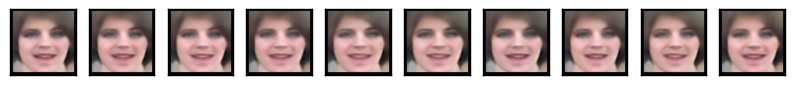

Iteration : 171 Best score : 12.2408025207


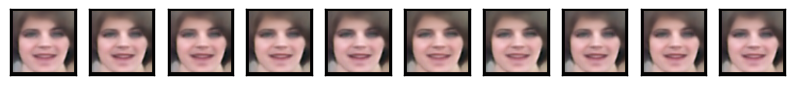

Iteration : 172 Best score : 12.2118210915


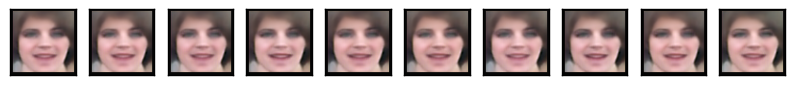

Iteration : 173 Best score : 12.2314918234


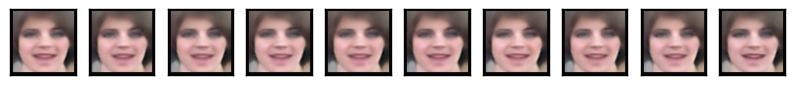

Iteration : 174 Best score : 12.2118360054


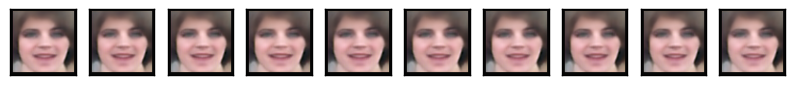

Iteration : 175 Best score : 12.146948772


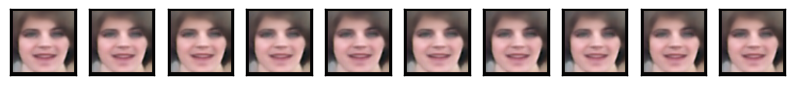

Iteration : 176 Best score : 12.1612217124


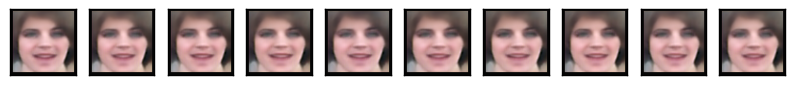

Iteration : 177 Best score : 12.1829728887


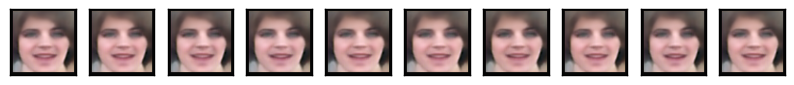

Iteration : 178 Best score : 12.1538157291


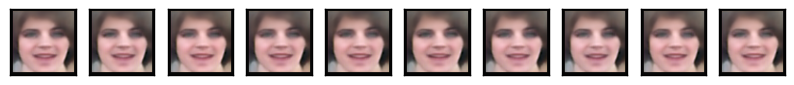

Iteration : 179 Best score : 12.1748502603


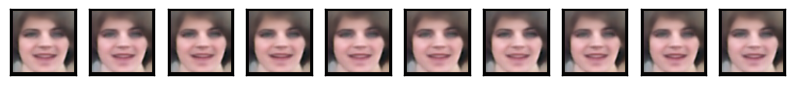

Iteration : 180 Best score : 12.1417580993


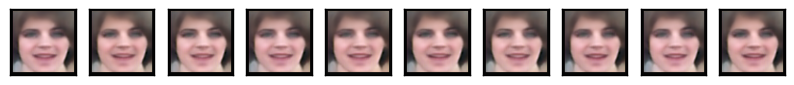

Iteration : 181 Best score : 12.1458766818


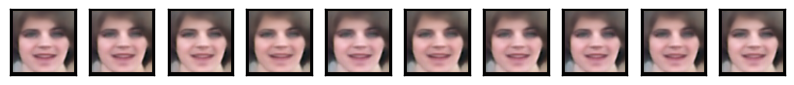

Iteration : 182 Best score : 12.1594421476


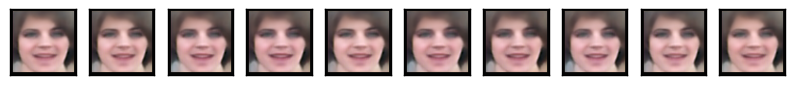

Iteration : 183 Best score : 12.2100298056


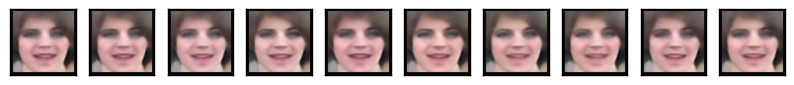

Iteration : 184 Best score : 12.1477812372


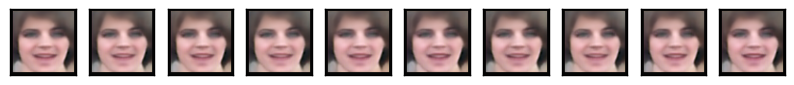

Iteration : 185 Best score : 12.1309179719


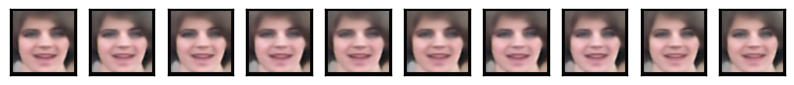

Iteration : 186 Best score : 12.1598716266


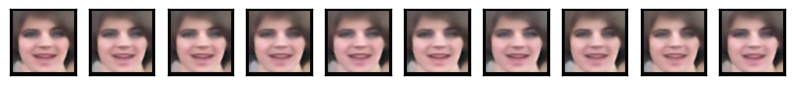

Iteration : 187 Best score : 12.1604317672


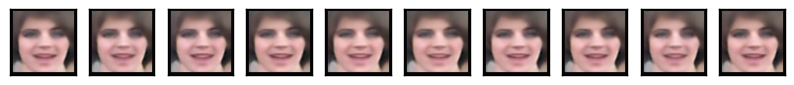

Iteration : 188 Best score : 12.1763914858


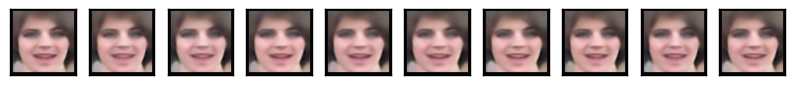

Iteration : 189 Best score : 12.1489359962


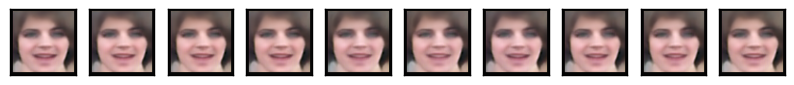

Iteration : 190 Best score : 12.1441866035


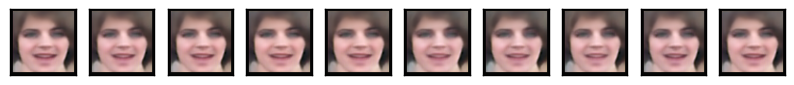

Iteration : 191 Best score : 12.1346357183


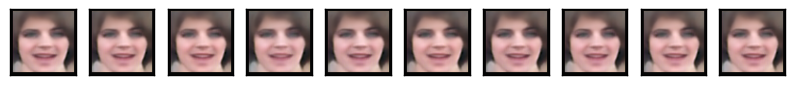

Iteration : 192 Best score : 12.1696264798


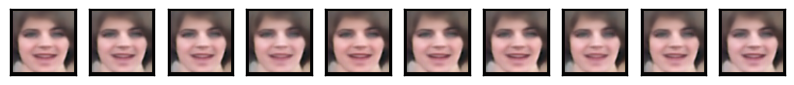

Iteration : 193 Best score : 12.148342892


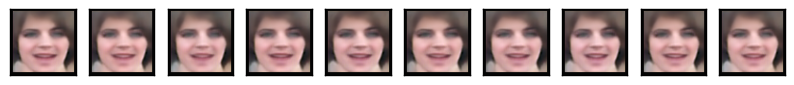

Iteration : 194 Best score : 12.1927188796


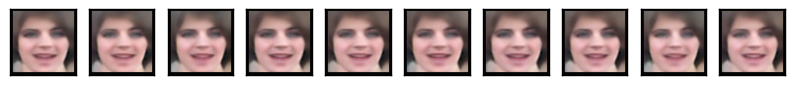

Iteration : 195 Best score : 12.2005876303


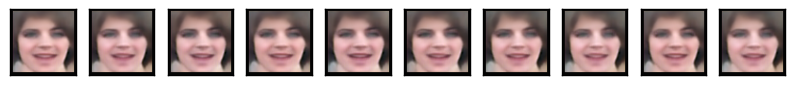

Iteration : 196 Best score : 12.1926124623


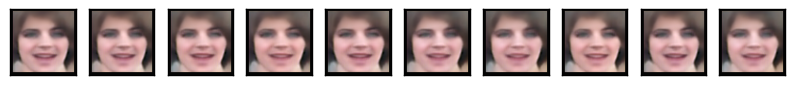

Iteration : 197 Best score : 12.2046416221


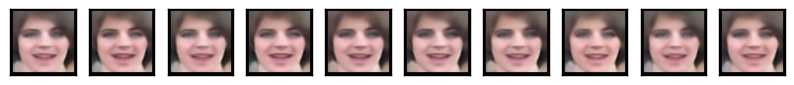

Iteration : 198 Best score : 12.1724021017


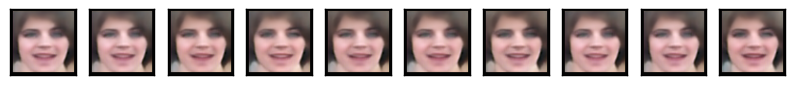

Iteration : 199 Best score : 12.1833616932


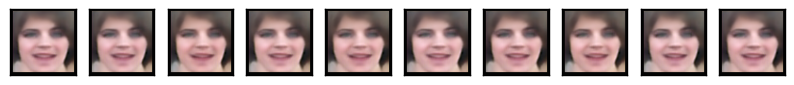

Iteration : 200 Best score : 12.2240107907


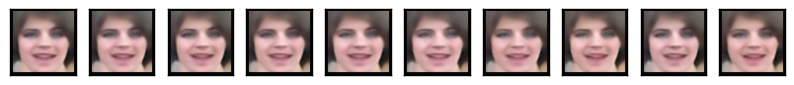

Iteration : 201 Best score : 12.2156763817


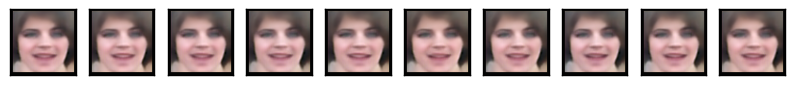

Iteration : 202 Best score : 12.221237082


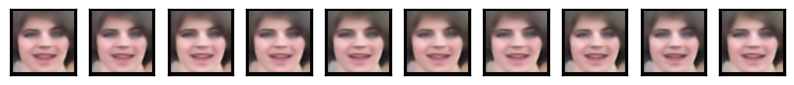

Iteration : 203 Best score : 12.2443072958


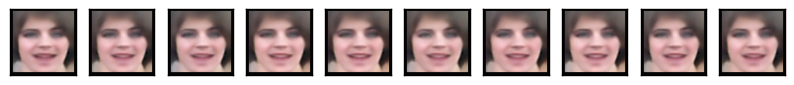

Iteration : 204 Best score : 12.2418161664


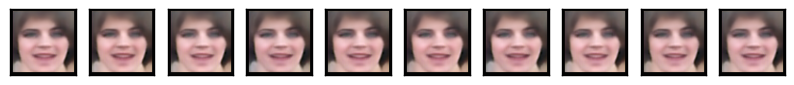

Iteration : 205 Best score : 12.2311456736


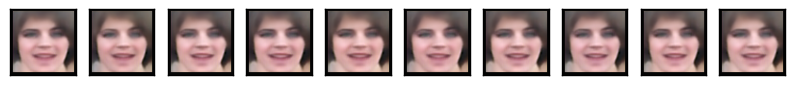

Iteration : 206 Best score : 12.2026518011


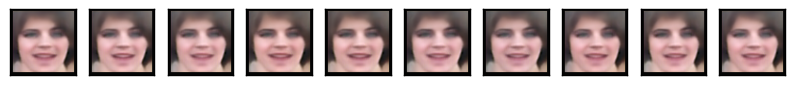

Iteration : 207 Best score : 12.2469122399


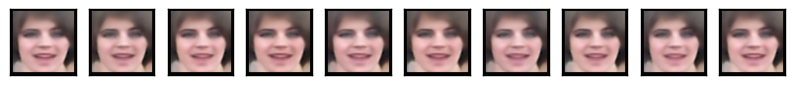

Iteration : 208 Best score : 12.2001602014


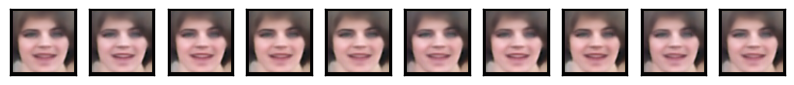

Iteration : 209 Best score : 12.2017483091


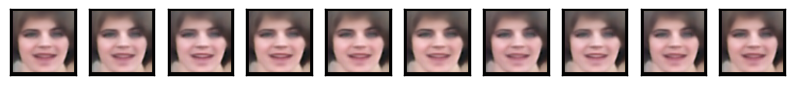

Iteration : 210 Best score : 12.1685836321


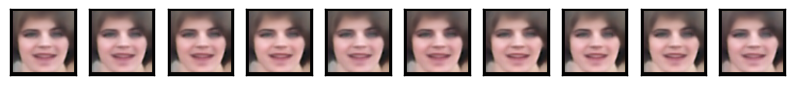

Iteration : 211 Best score : 12.1873840974


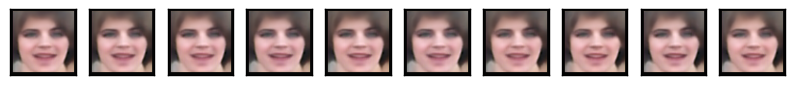

Iteration : 212 Best score : 12.1834588707


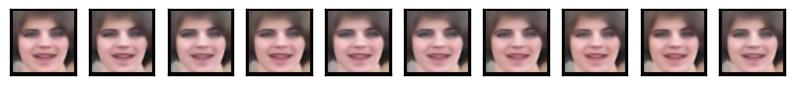

Iteration : 213 Best score : 12.2080057758


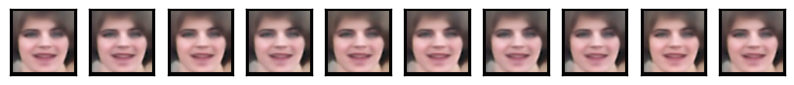

Iteration : 214 Best score : 12.2069322759


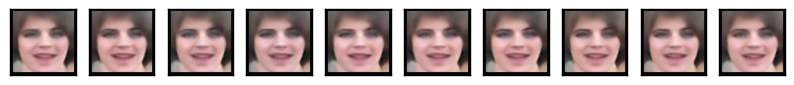

Iteration : 215 Best score : 12.2096562169


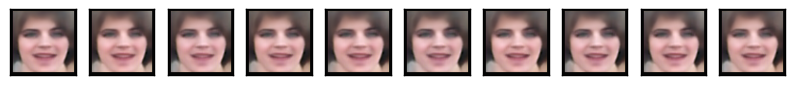

Iteration : 216 Best score : 12.1861403098


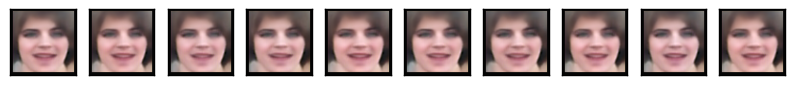

Iteration : 217 Best score : 12.1887535318


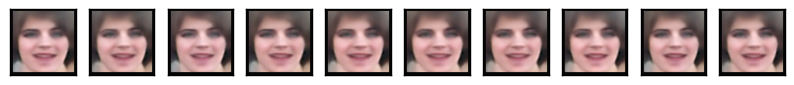

Iteration : 218 Best score : 12.221005592


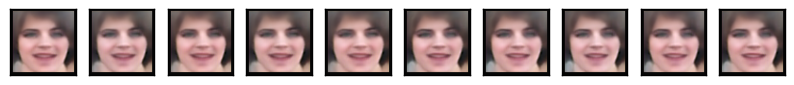

Iteration : 219 Best score : 12.1777194662


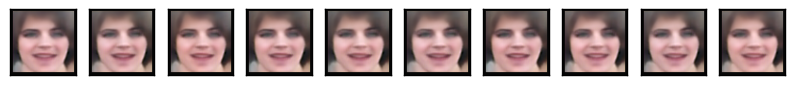

Iteration : 220 Best score : 12.2000847538


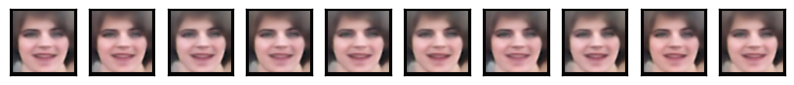

Iteration : 221 Best score : 12.2396524788


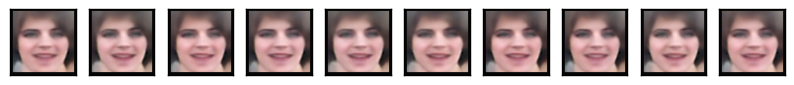

Iteration : 222 Best score : 12.2528512641


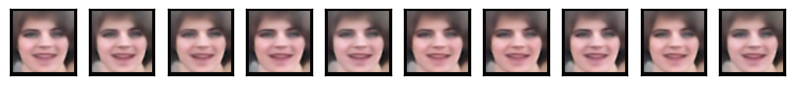

Iteration : 223 Best score : 12.2249385597


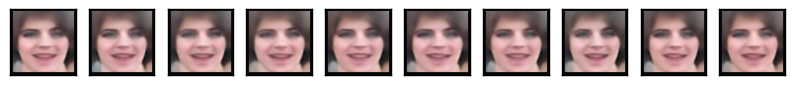

Iteration : 224 Best score : 12.1966786599


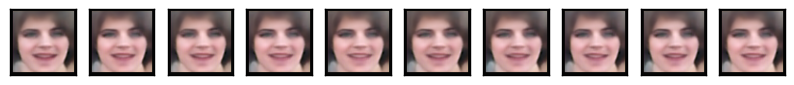

Iteration : 225 Best score : 12.2423129602


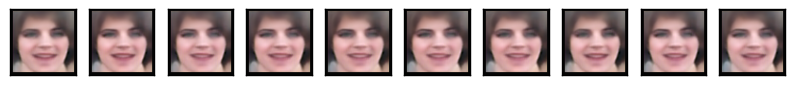

Iteration : 226 Best score : 12.2394880791


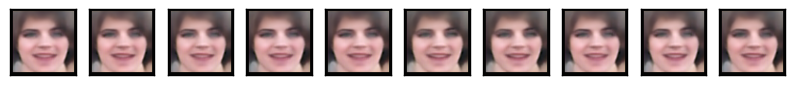

Iteration : 227 Best score : 12.1875572893


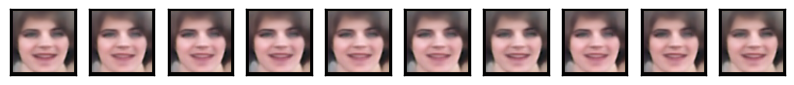

Iteration : 228 Best score : 12.2028023038


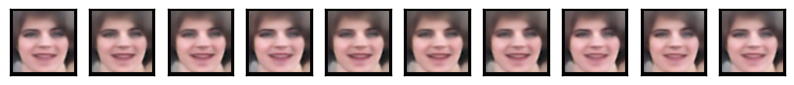

Iteration : 229 Best score : 12.1905528339


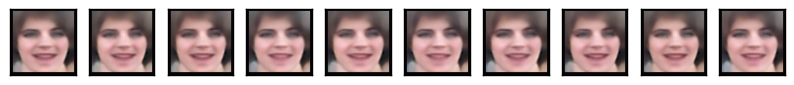

Iteration : 230 Best score : 12.1768343419


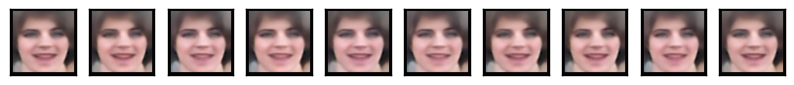

Iteration : 231 Best score : 12.2247913523


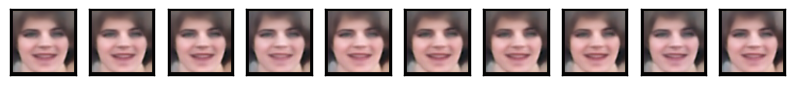

Iteration : 232 Best score : 12.1650631334


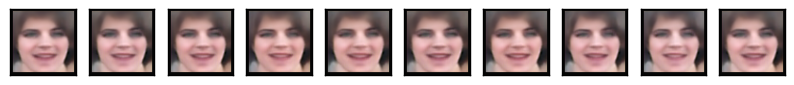

Iteration : 233 Best score : 12.2023206155


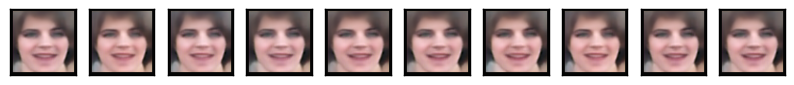

Iteration : 234 Best score : 12.1796054593


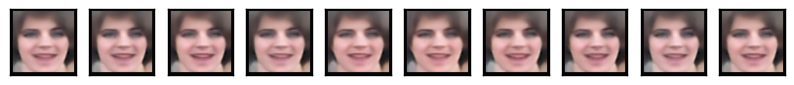

Iteration : 235 Best score : 12.18765406


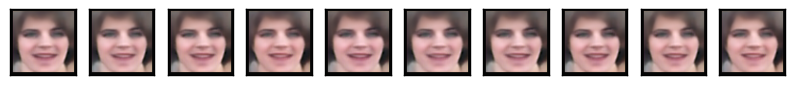

Iteration : 236 Best score : 12.1943744881


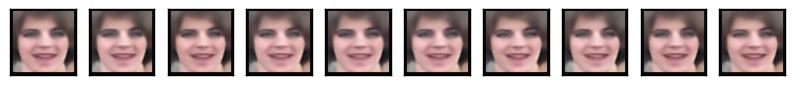

Iteration : 237 Best score : 12.2072169905


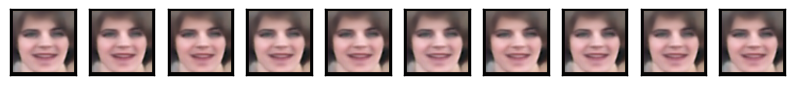

Iteration : 238 Best score : 12.2002859348


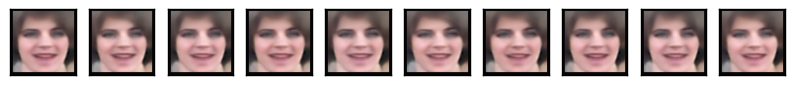

Iteration : 239 Best score : 12.176293619


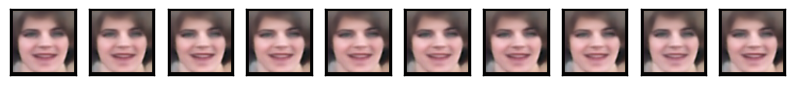

Iteration : 240 Best score : 12.195956651


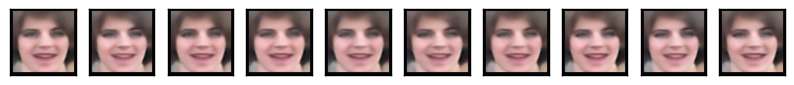

Iteration : 241 Best score : 12.2351070384


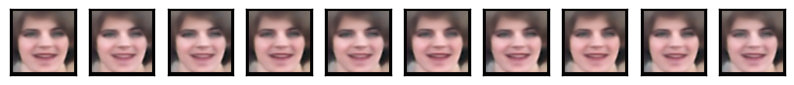

Iteration : 242 Best score : 12.2323688497


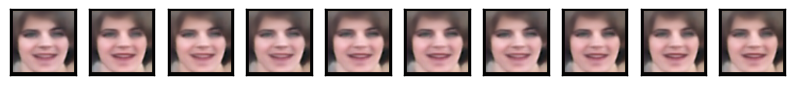

Iteration : 243 Best score : 12.256665945


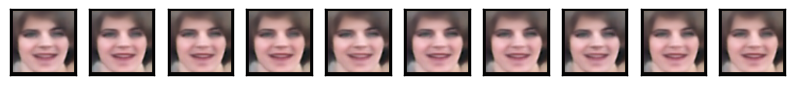

Iteration : 244 Best score : 12.2352333103


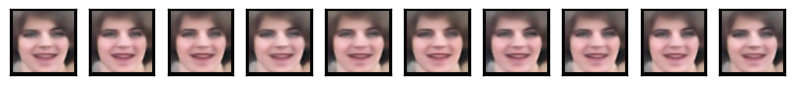

Iteration : 245 Best score : 12.2508500073


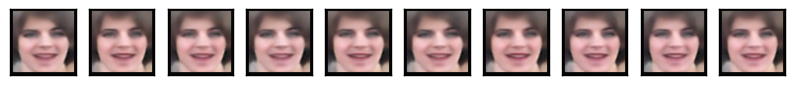

Iteration : 246 Best score : 12.2579912444


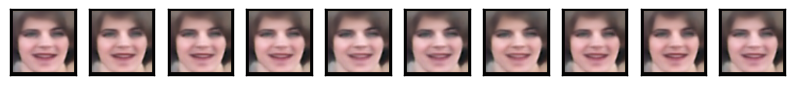

Iteration : 247 Best score : 12.2571981758


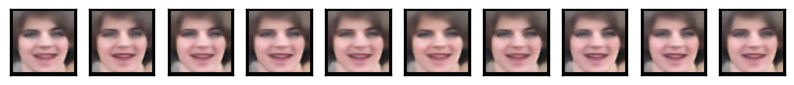

Iteration : 248 Best score : 12.2634732523


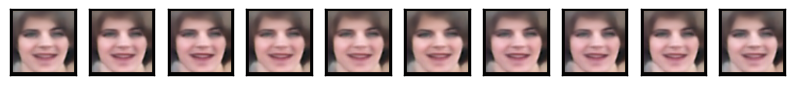

Iteration : 249 Best score : 12.2276775693


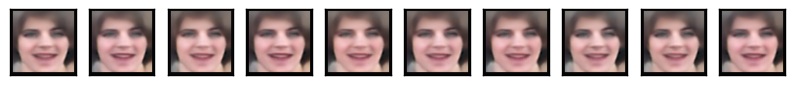

Iteration : 250 Best score : 12.245302974


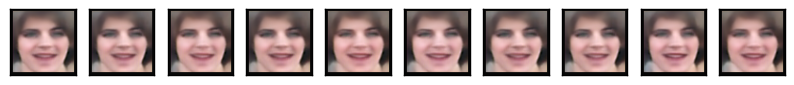

Iteration : 251 Best score : 12.2599498487


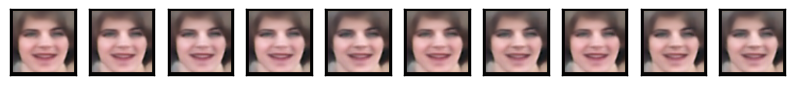

Iteration : 252 Best score : 12.281031684


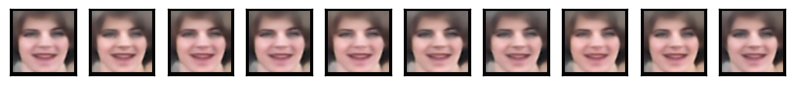

Iteration : 253 Best score : 12.2472721688


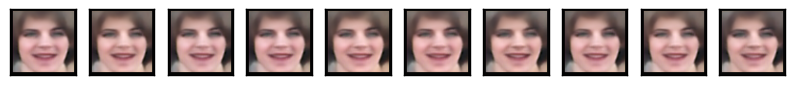

Iteration : 254 Best score : 12.2597982295


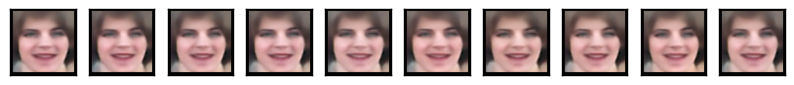

Iteration : 255 Best score : 12.2924980175


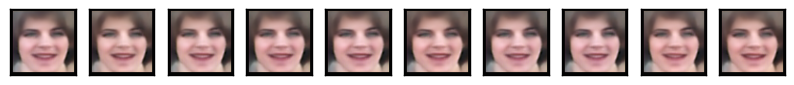

Iteration : 256 Best score : 12.288601491


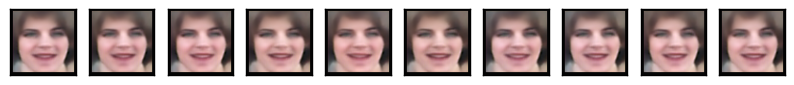

Iteration : 257 Best score : 12.2825474574


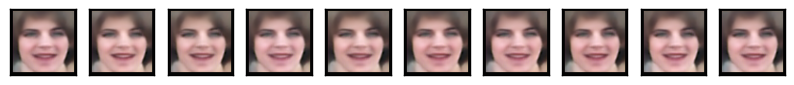

Iteration : 258 Best score : 12.2968041775


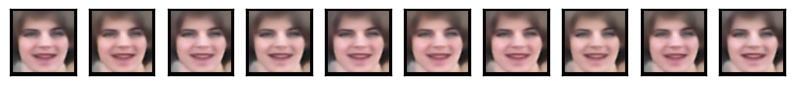

Iteration : 259 Best score : 12.2645490793


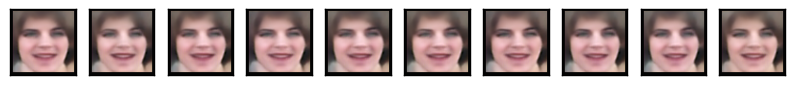

Iteration : 260 Best score : 12.2386414762


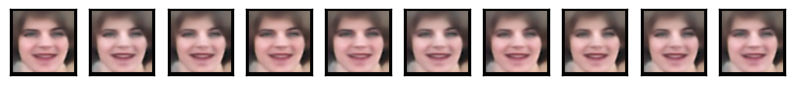

Iteration : 261 Best score : 12.2431034626


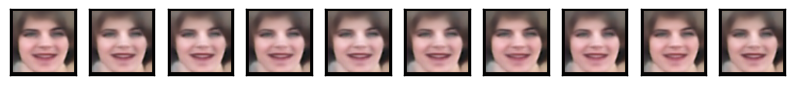

Iteration : 262 Best score : 12.2566516849


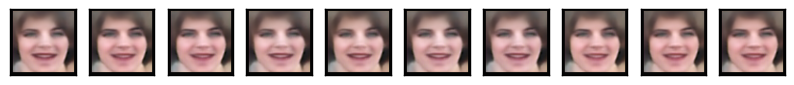

Iteration : 263 Best score : 12.2620890186


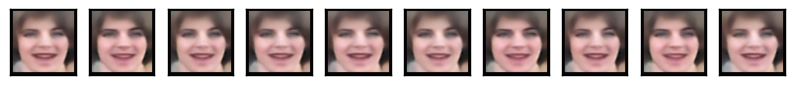

Iteration : 264 Best score : 12.2528130914


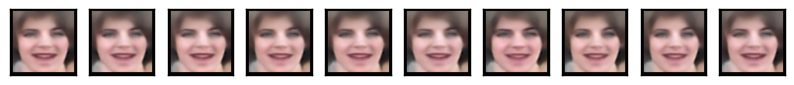

Iteration : 265 Best score : 12.2802520437


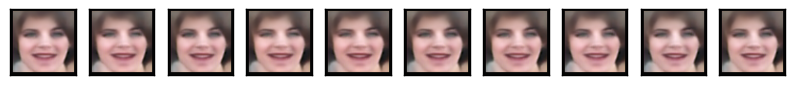

Iteration : 266 Best score : 12.2928189874


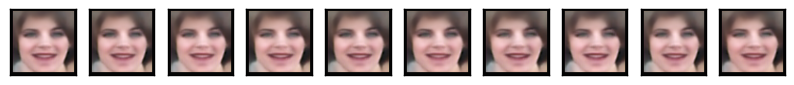

Iteration : 267 Best score : 12.258679327


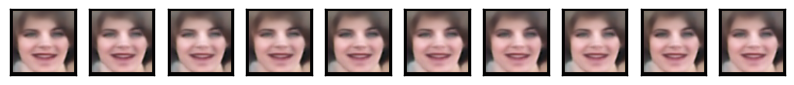

Iteration : 268 Best score : 12.2516863415


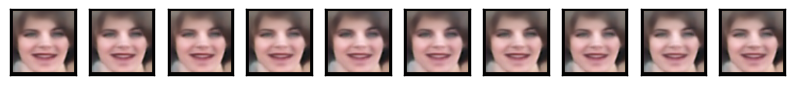

Iteration : 269 Best score : 12.2002255847


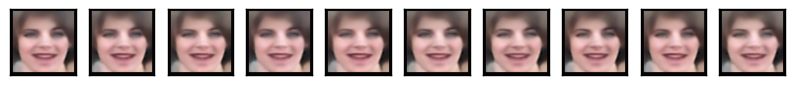

Iteration : 270 Best score : 12.1725106914


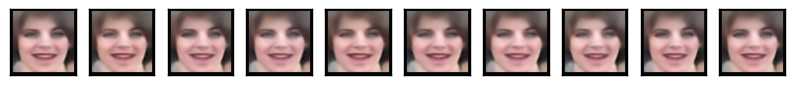

Iteration : 271 Best score : 12.2466194022


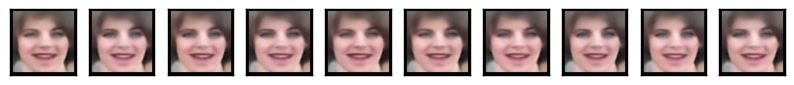

Iteration : 272 Best score : 12.2669137145


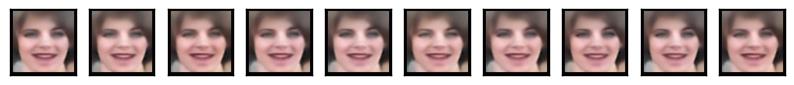

Iteration : 273 Best score : 12.2446008112


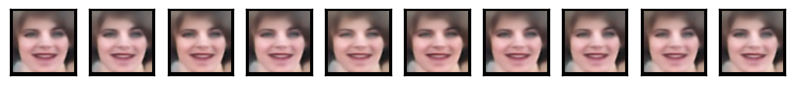

Iteration : 274 Best score : 12.2319840273


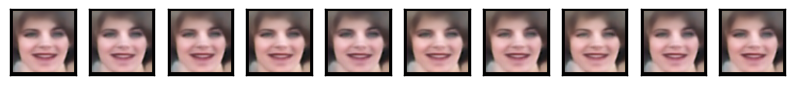

Iteration : 275 Best score : 12.2496588162


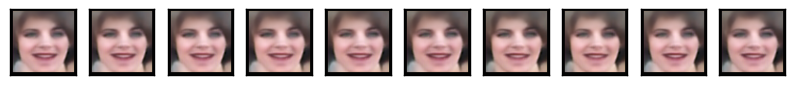

Iteration : 276 Best score : 12.2381622232


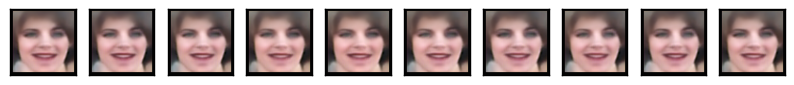

Iteration : 277 Best score : 12.2246392151


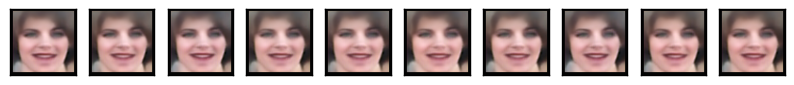

Iteration : 278 Best score : 12.2239174752


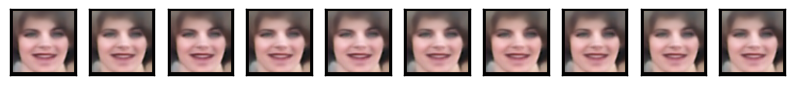

Iteration : 279 Best score : 12.2385591966


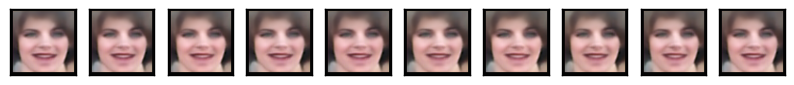

Iteration : 280 Best score : 12.2149184062


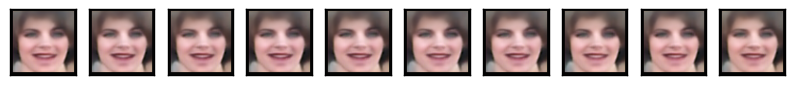

Iteration : 281 Best score : 12.1920295005


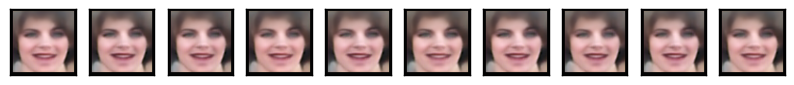

Iteration : 282 Best score : 12.1763605815


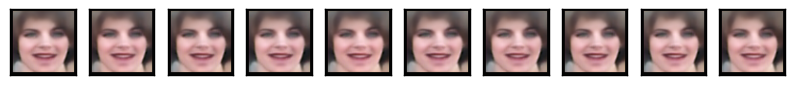

Iteration : 283 Best score : 12.193367273


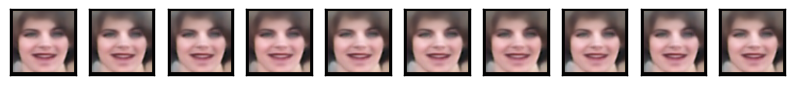

Iteration : 284 Best score : 12.1814674041


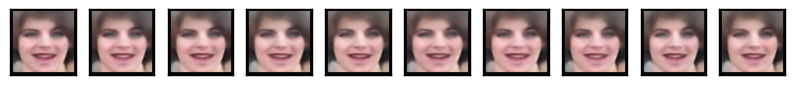

Iteration : 285 Best score : 12.1705698125


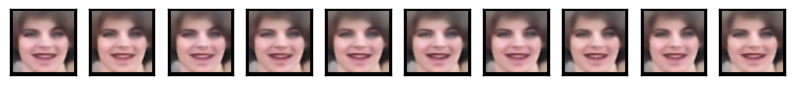

Iteration : 286 Best score : 12.1703107438


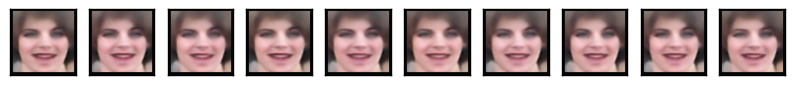

Iteration : 287 Best score : 12.1654589626


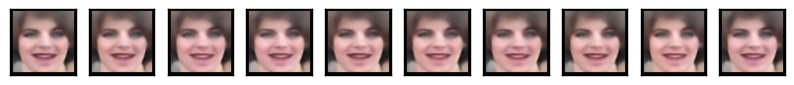

Iteration : 288 Best score : 12.1777040347


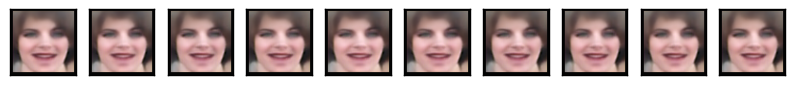

Iteration : 289 Best score : 12.1724382995


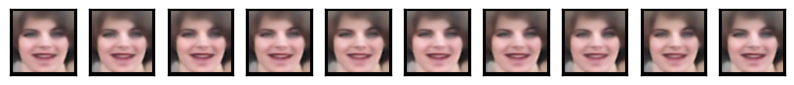

Iteration : 290 Best score : 12.1533994522


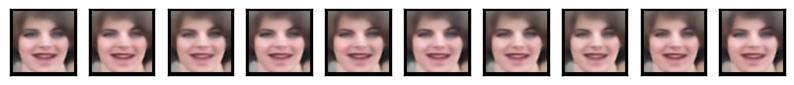

Iteration : 291 Best score : 12.1772101008


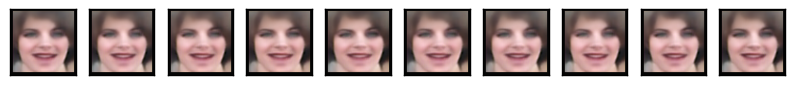

Iteration : 292 Best score : 12.1898619595


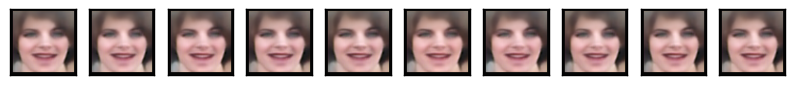

Iteration : 293 Best score : 12.1954817596


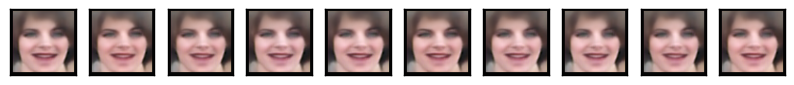

Iteration : 294 Best score : 12.1476222209


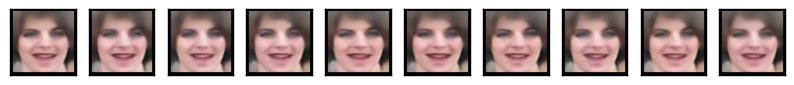

Iteration : 295 Best score : 12.1651100161


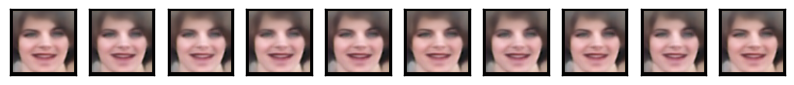

Iteration : 296 Best score : 12.1540685723


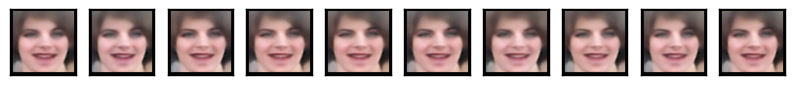

Iteration : 297 Best score : 12.1695020178


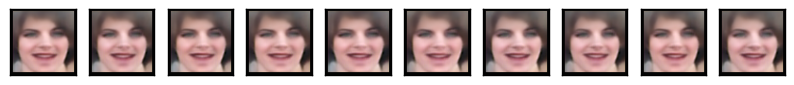

Iteration : 298 Best score : 12.1871395401


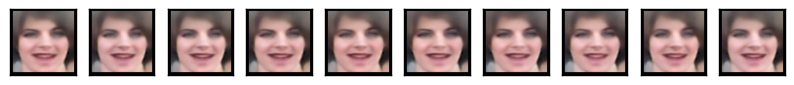

Iteration : 299 Best score : 12.1391847


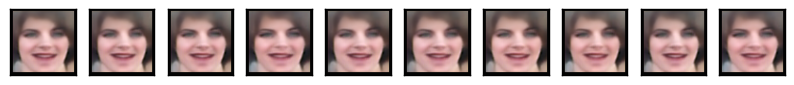

Iteration : 300 Best score : 12.175288643


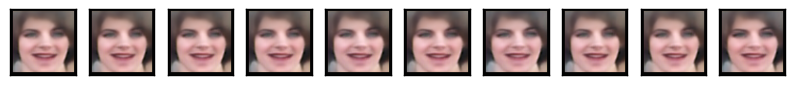

Iteration : 301 Best score : 12.1460837591


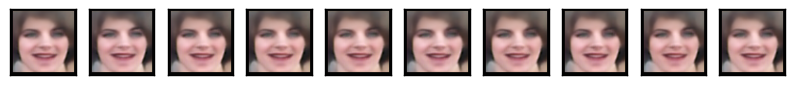

Iteration : 302 Best score : 12.171419087


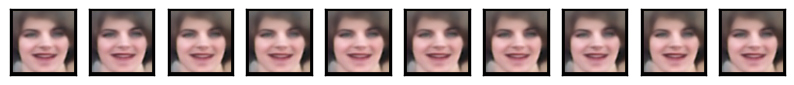

Iteration : 303 Best score : 12.1555106626


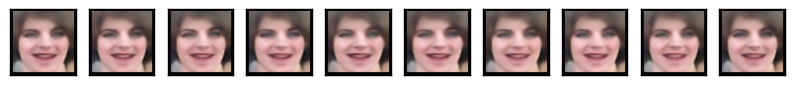

Iteration : 304 Best score : 12.1432979014


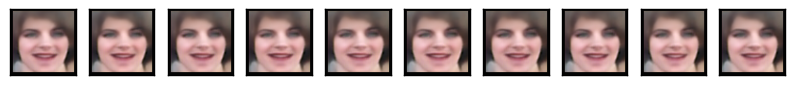

Iteration : 305 Best score : 12.1379115709


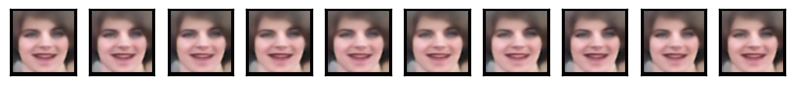

Iteration : 306 Best score : 12.1646723588


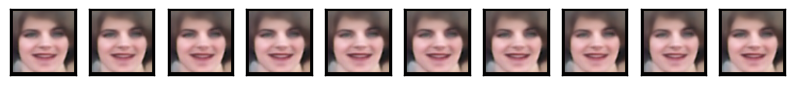

Iteration : 307 Best score : 12.1383450447


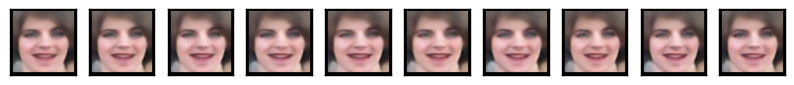

Iteration : 308 Best score : 12.1784084973


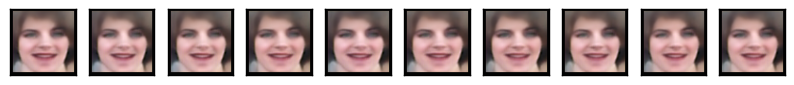

Iteration : 309 Best score : 12.1353336075


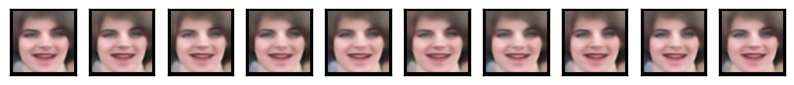

Iteration : 310 Best score : 12.1697768506


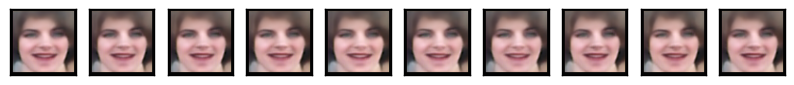

Iteration : 311 Best score : 12.1669263296


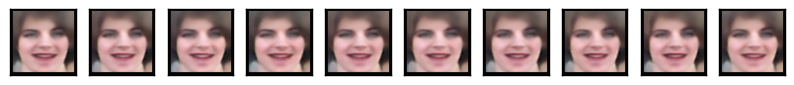

Iteration : 312 Best score : 12.1442983005


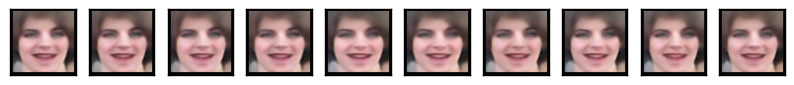

Iteration : 313 Best score : 12.1487824583


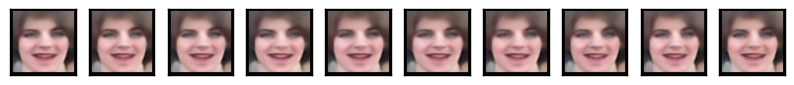

Iteration : 314 Best score : 12.1149765739


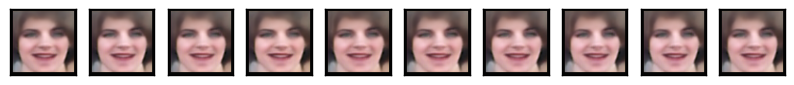

Iteration : 315 Best score : 12.1471927508


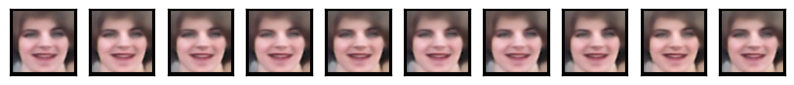

Iteration : 316 Best score : 12.1584095959


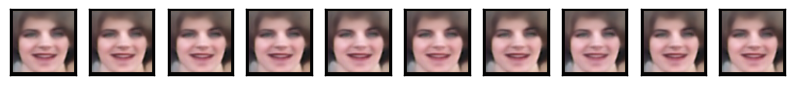

Iteration : 317 Best score : 12.1386606666


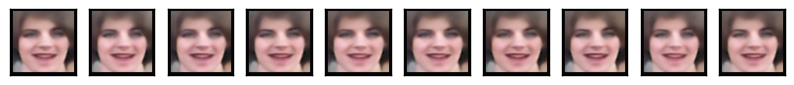

Iteration : 318 Best score : 12.1256702899


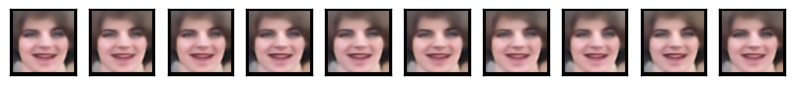

Iteration : 319 Best score : 12.1270240269


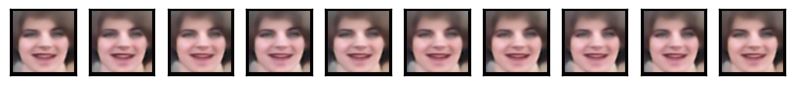

Iteration : 320 Best score : 12.1589391084


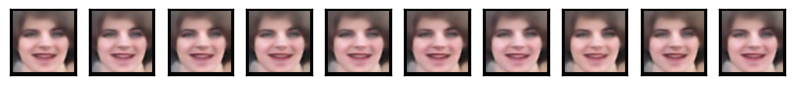

Iteration : 321 Best score : 12.1321623461


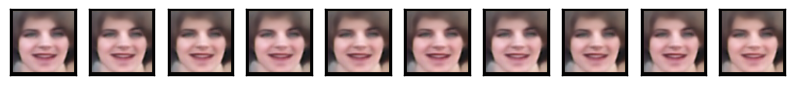

Iteration : 322 Best score : 12.1442397941


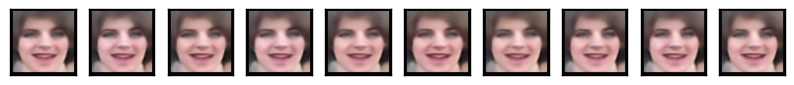

Iteration : 323 Best score : 12.1033142969


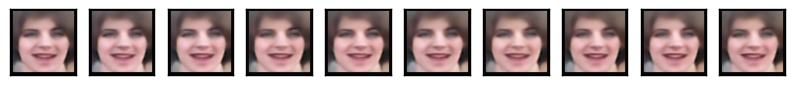

Iteration : 324 Best score : 12.0909086771


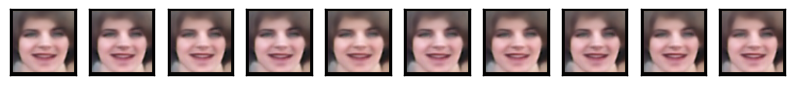

Iteration : 325 Best score : 12.0970777558


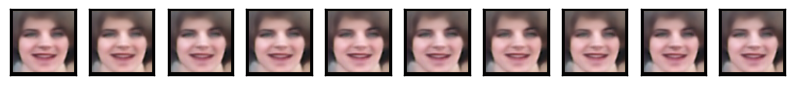

Iteration : 326 Best score : 12.1706267986


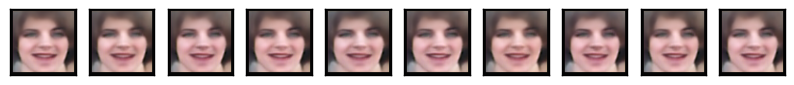

Iteration : 327 Best score : 12.1620894095


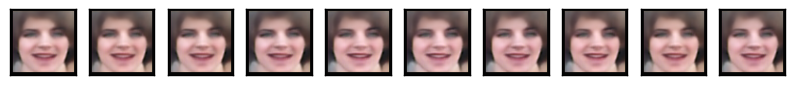

Iteration : 328 Best score : 12.1604055993


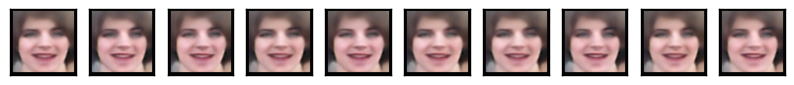

Iteration : 329 Best score : 12.2053323716


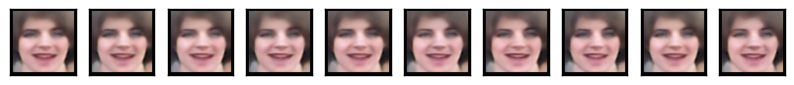

Iteration : 330 Best score : 12.1718331057


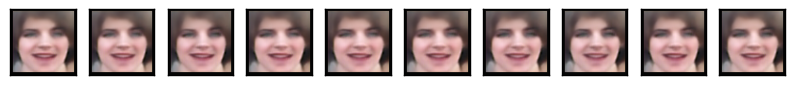

Iteration : 331 Best score : 12.1973295357


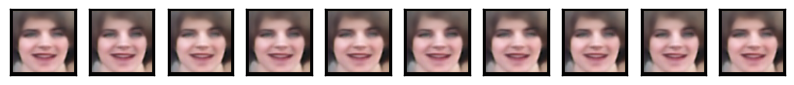

Iteration : 332 Best score : 12.2041858667


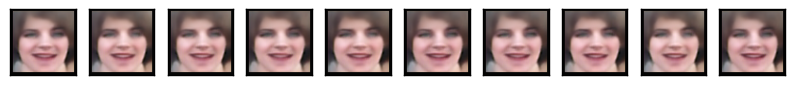

Iteration : 333 Best score : 12.1865635751


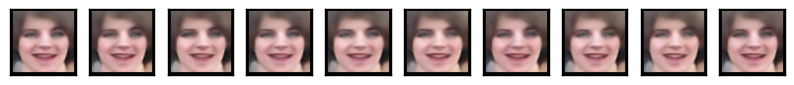

Iteration : 334 Best score : 12.2043060861


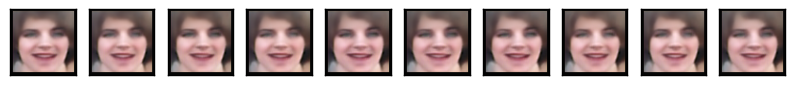

Iteration : 335 Best score : 12.1710722144


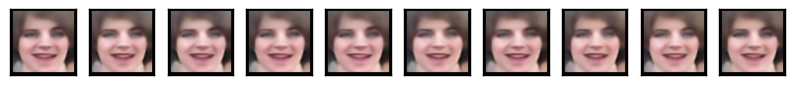

Iteration : 336 Best score : 12.215824937


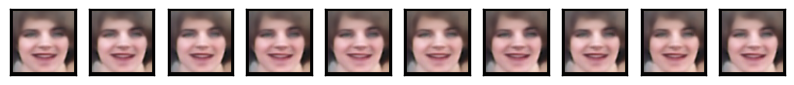

Iteration : 337 Best score : 12.2047868192


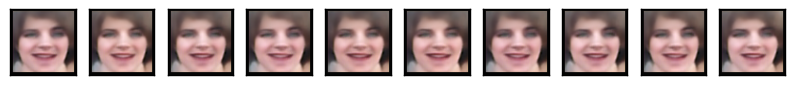

Iteration : 338 Best score : 12.1744013636


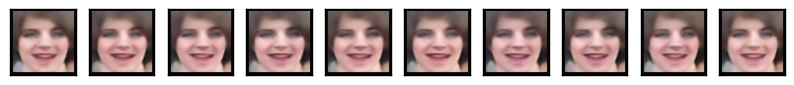

Iteration : 339 Best score : 12.2115874112


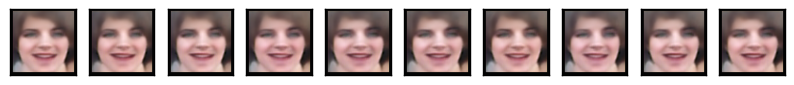

Iteration : 340 Best score : 12.2094170468


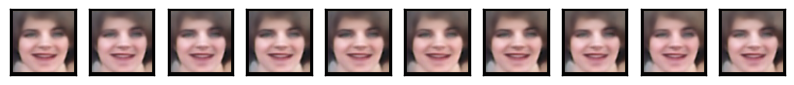

Iteration : 341 Best score : 12.2019190312


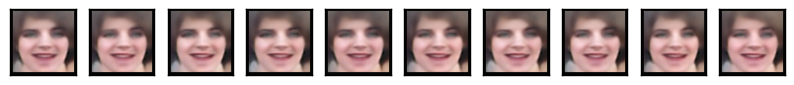

Iteration : 342 Best score : 12.1463438723


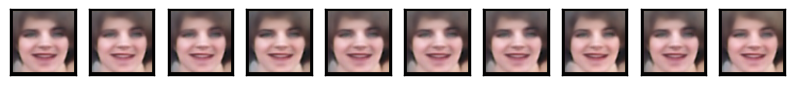

Iteration : 343 Best score : 12.1995262647


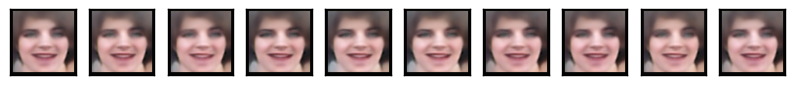

Iteration : 344 Best score : 12.1822460329


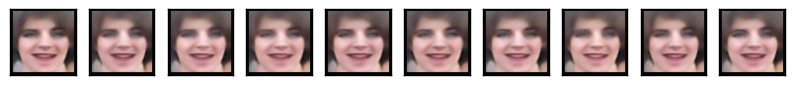

Iteration : 345 Best score : 12.1941215144


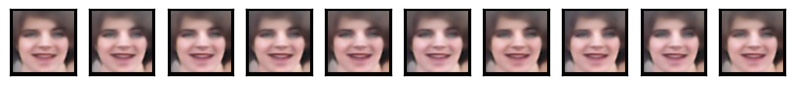

Iteration : 346 Best score : 12.1699634865


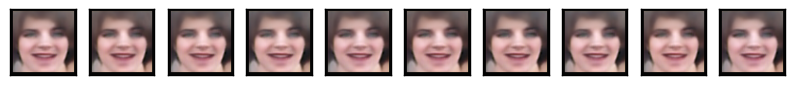

Iteration : 347 Best score : 12.1389601479


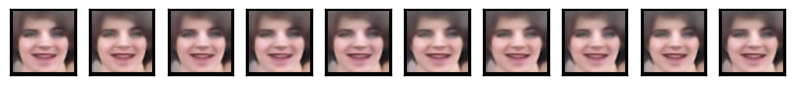

Iteration : 348 Best score : 12.1355804363


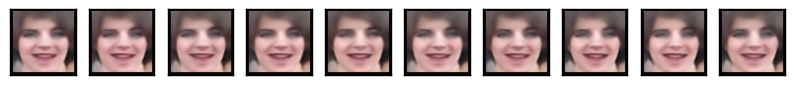

Iteration : 349 Best score : 12.1477335349


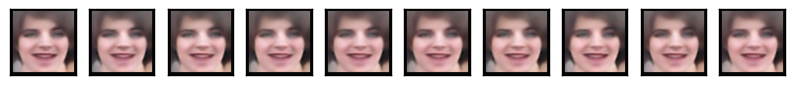

Iteration : 350 Best score : 12.1314460774


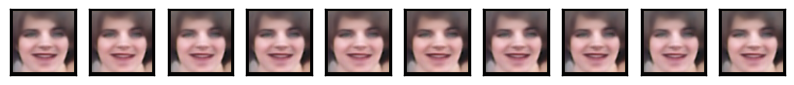

Iteration : 351 Best score : 12.1253234383


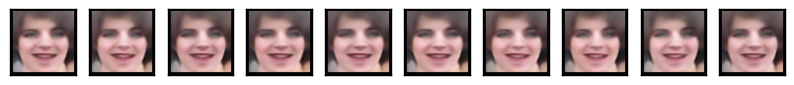

Iteration : 352 Best score : 12.1161752899


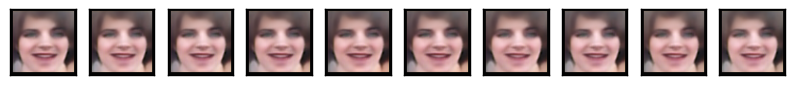

Iteration : 353 Best score : 12.0955153165


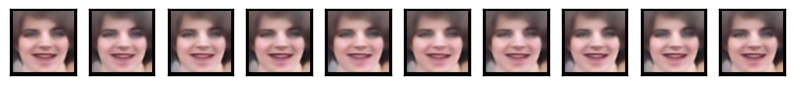

Iteration : 354 Best score : 12.1501898883


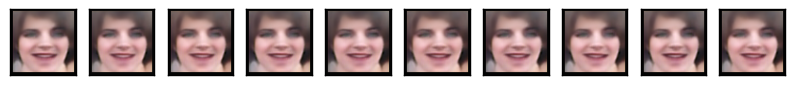

Iteration : 355 Best score : 12.1575334499


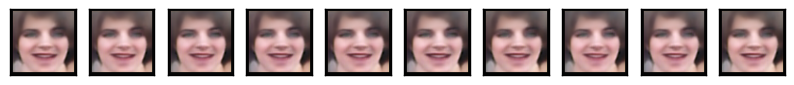

Iteration : 356 Best score : 12.1403921392


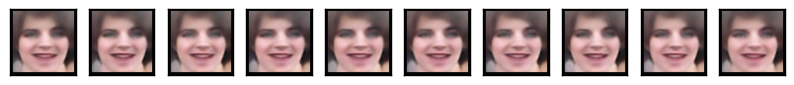

Iteration : 357 Best score : 12.1350384062


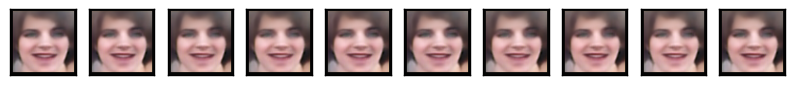

Iteration : 358 Best score : 12.1263582173


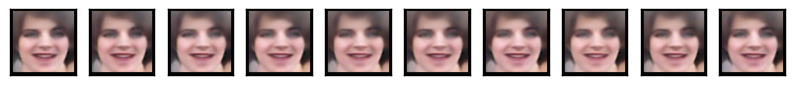

Iteration : 359 Best score : 12.1510513582


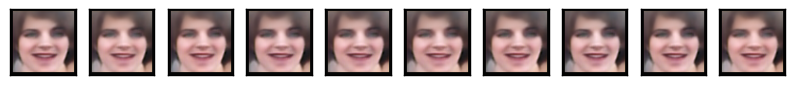

Iteration : 360 Best score : 12.1642710046


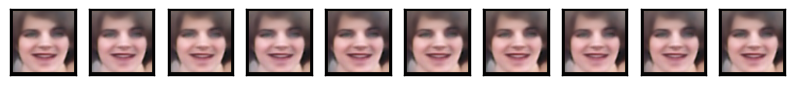

Iteration : 361 Best score : 12.1146259927


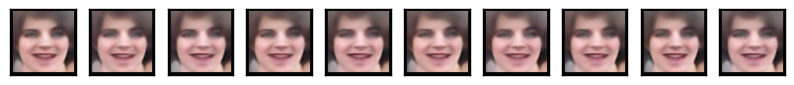

Iteration : 362 Best score : 12.1685213381


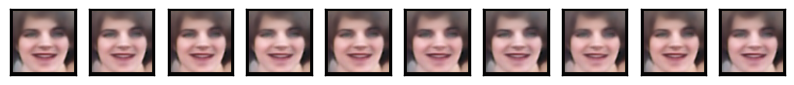

Iteration : 363 Best score : 12.1699686703


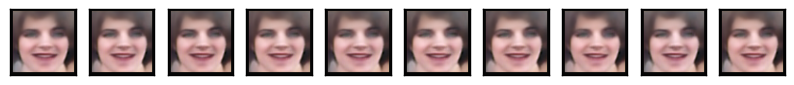

Iteration : 364 Best score : 12.1269590894


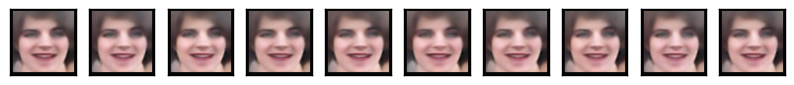

Iteration : 365 Best score : 12.1008121249


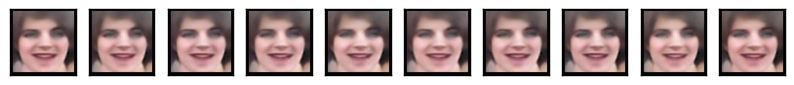

Iteration : 366 Best score : 12.1026768652


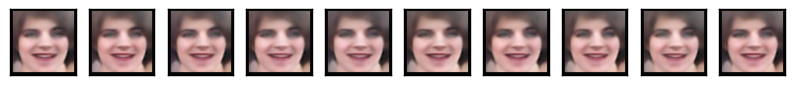

Iteration : 367 Best score : 12.1135460879


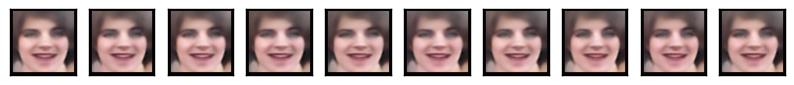

Iteration : 368 Best score : 12.1257407294


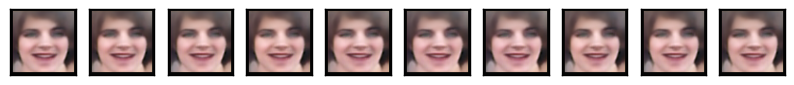

Iteration : 369 Best score : 12.12979617


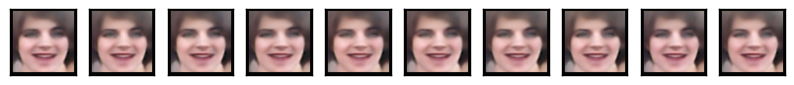

Iteration : 370 Best score : 12.1214184881


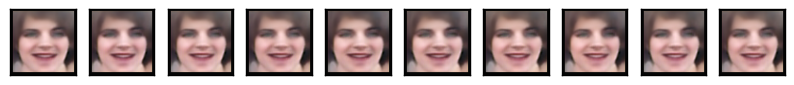

Iteration : 371 Best score : 12.0961405852


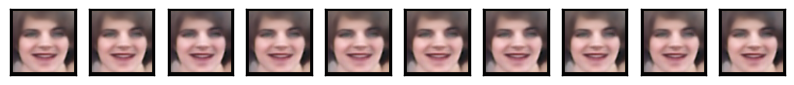

Iteration : 372 Best score : 12.0675574257


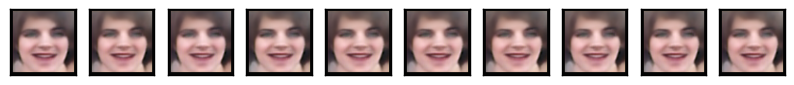

Iteration : 373 Best score : 12.0901116989


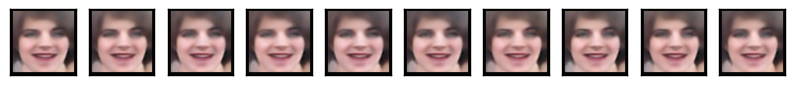

Iteration : 374 Best score : 12.0854631191


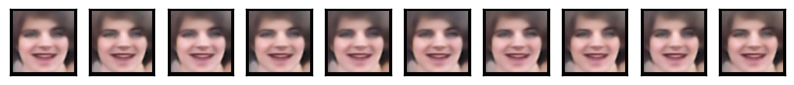

Iteration : 375 Best score : 12.1198391477


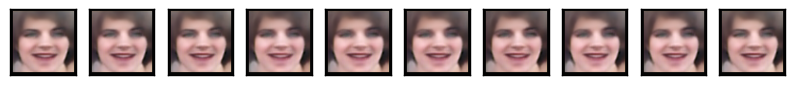

Iteration : 376 Best score : 12.1179297195


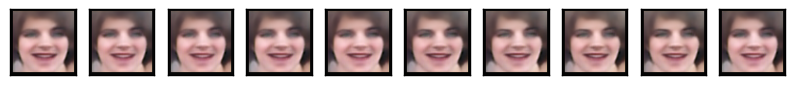

Iteration : 377 Best score : 12.0942971534


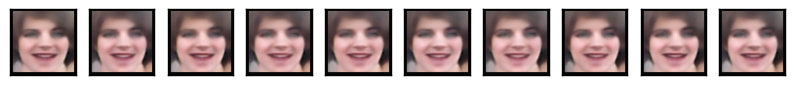

Iteration : 378 Best score : 12.1108659604


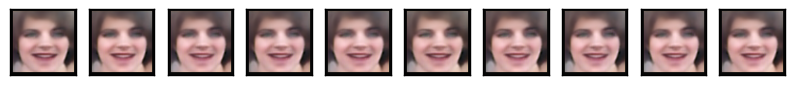

Iteration : 379 Best score : 12.0918899957


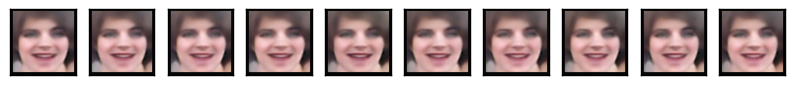

Iteration : 380 Best score : 12.1192721554


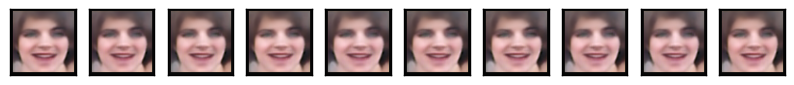

Iteration : 381 Best score : 12.1275217412


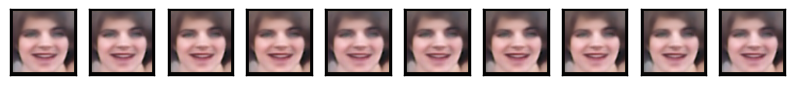

Iteration : 382 Best score : 12.1037408719


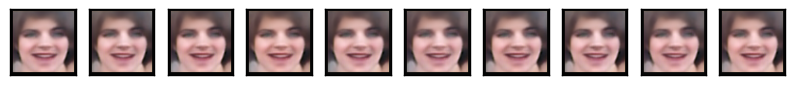

Iteration : 383 Best score : 12.1400022851


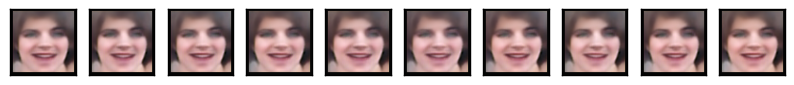

Iteration : 384 Best score : 12.1522023493


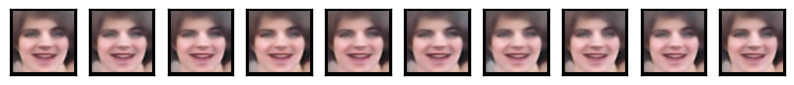

Iteration : 385 Best score : 12.1236471012


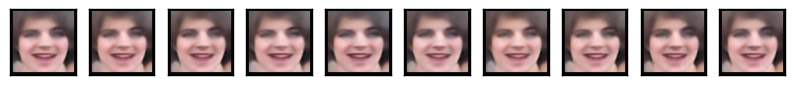

Iteration : 386 Best score : 12.1369636959


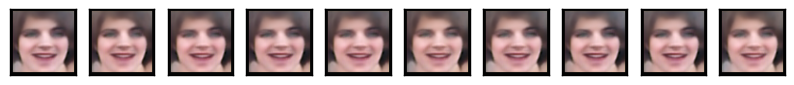

Iteration : 387 Best score : 12.1532360556


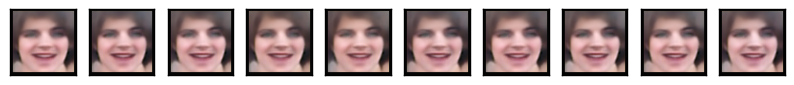

Iteration : 388 Best score : 12.1155241111


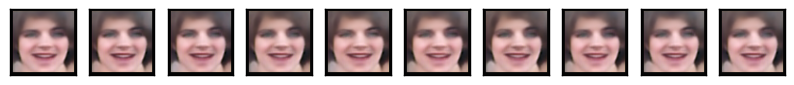

Iteration : 389 Best score : 12.1784496185


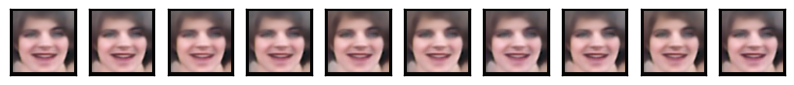

Iteration : 390 Best score : 12.1371297728


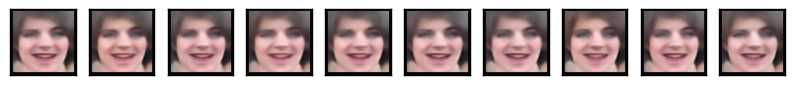

Iteration : 391 Best score : 12.1778069069


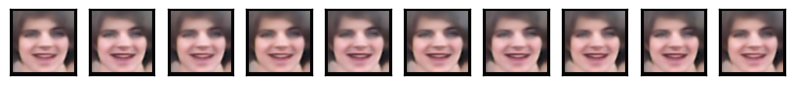

Iteration : 392 Best score : 12.1066886791


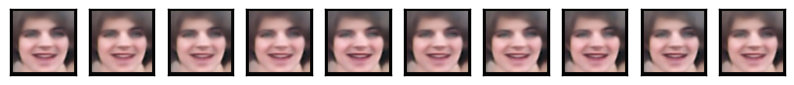

Iteration : 393 Best score : 12.1178696498


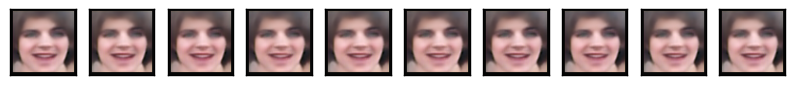

Iteration : 394 Best score : 12.0750010822


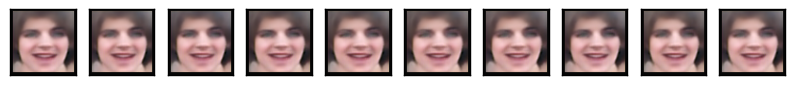

Iteration : 395 Best score : 12.0670864022


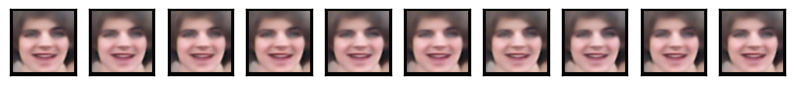

Iteration : 396 Best score : 12.0954650547


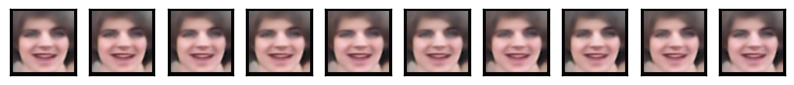

Iteration : 397 Best score : 12.0844698238


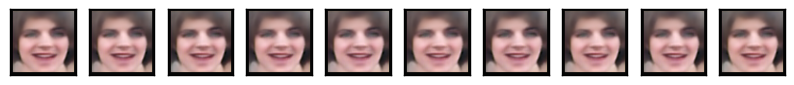

Iteration : 398 Best score : 12.0886564176


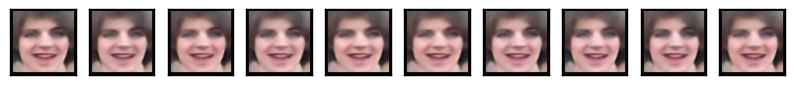

Iteration : 399 Best score : 12.0055708247


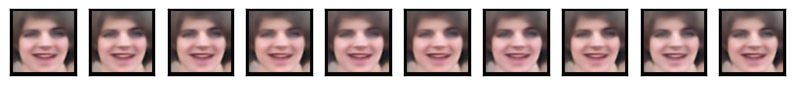

Iteration : 400 Best score : 12.038405191


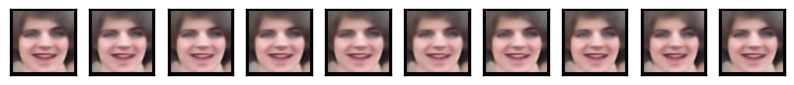

Iteration : 401 Best score : 12.0415340308


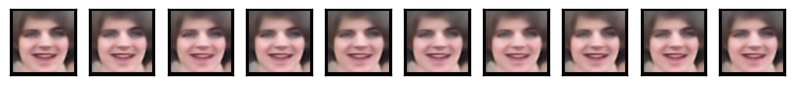

Iteration : 402 Best score : 11.9593405594


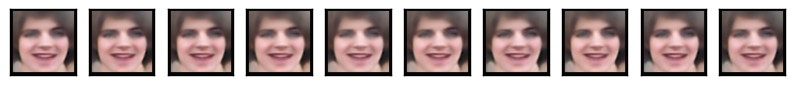

Iteration : 403 Best score : 12.0296039274


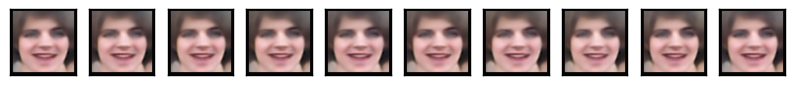

Iteration : 404 Best score : 12.0485412575


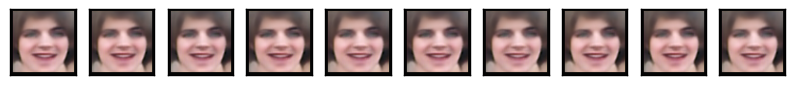

Iteration : 405 Best score : 12.0445003267


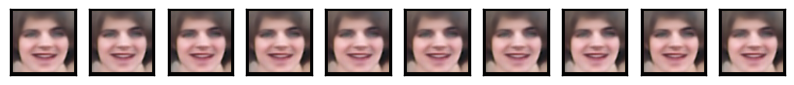

Iteration : 406 Best score : 12.0626063505


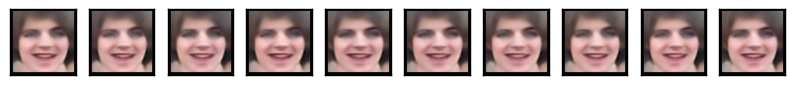

Iteration : 407 Best score : 12.0648891933


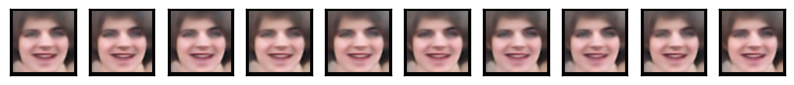

Iteration : 408 Best score : 12.0477859241


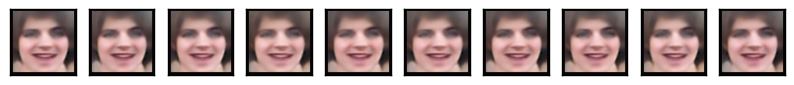

Iteration : 409 Best score : 12.0687053337


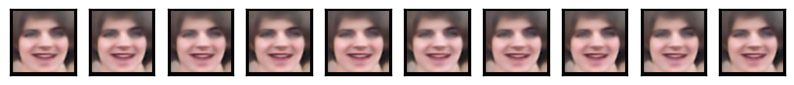

Iteration : 410 Best score : 12.0595602198


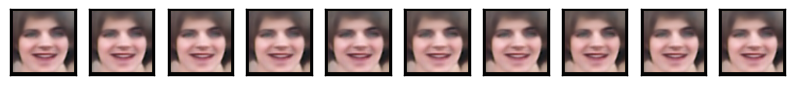

Iteration : 411 Best score : 12.0978692037


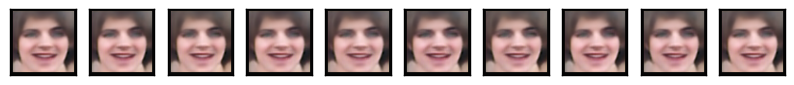

Iteration : 412 Best score : 12.1269320308


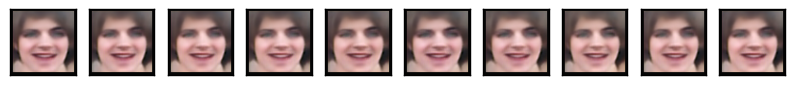

Iteration : 413 Best score : 12.1224355692


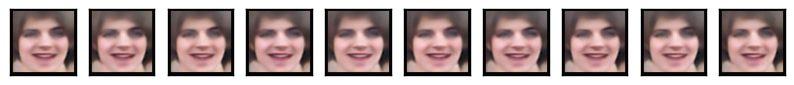

Iteration : 414 Best score : 12.1324960706


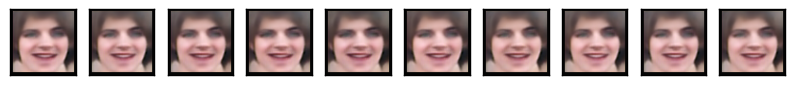

Iteration : 415 Best score : 12.1595416775


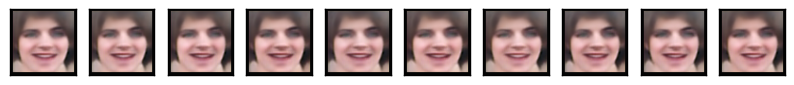

Iteration : 416 Best score : 12.1315753668


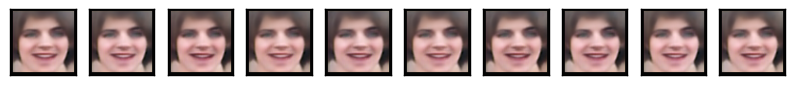

Iteration : 417 Best score : 12.0975794504


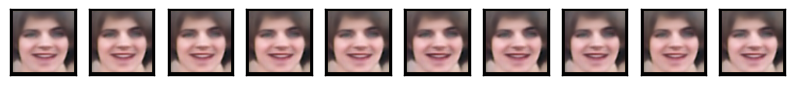

Iteration : 418 Best score : 12.1294075606


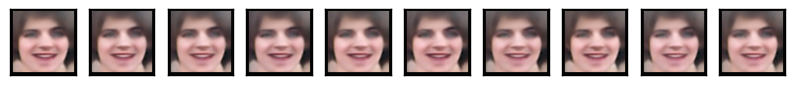

Iteration : 419 Best score : 12.1404134967


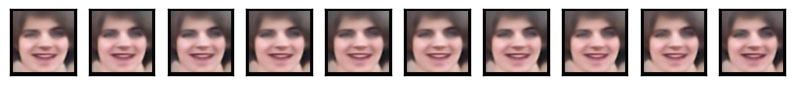

Iteration : 420 Best score : 12.096514443


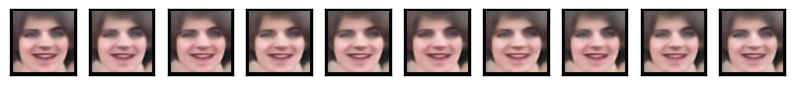

Iteration : 421 Best score : 12.1346142371


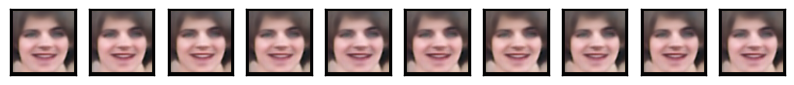

Iteration : 422 Best score : 12.0354741049


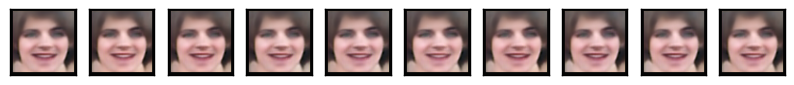

Iteration : 423 Best score : 12.0728783389


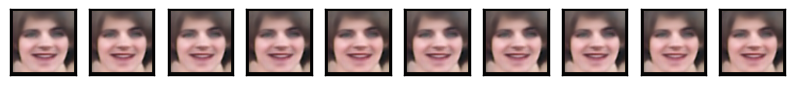

Iteration : 424 Best score : 12.0625890363


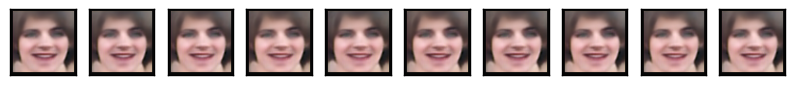

Iteration : 425 Best score : 12.0899039312


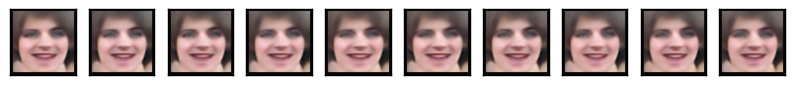

Iteration : 426 Best score : 12.057706039


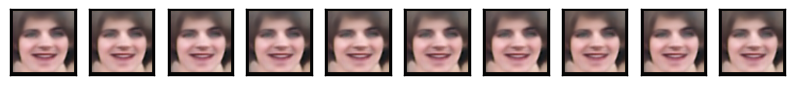

Iteration : 427 Best score : 12.0837129027


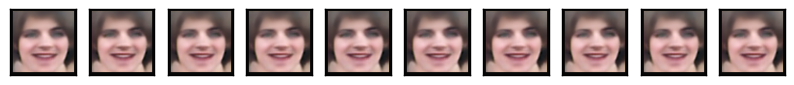

Iteration : 428 Best score : 12.0983482269


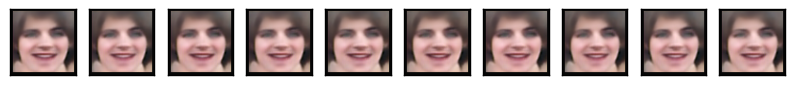

Iteration : 429 Best score : 12.0979583417


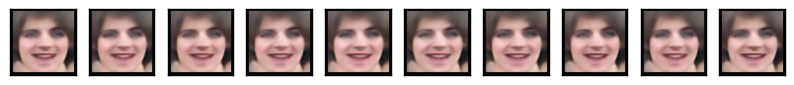

Iteration : 430 Best score : 12.0732781242


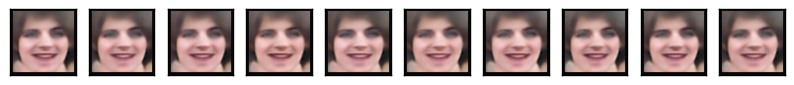

Iteration : 431 Best score : 12.0917722883


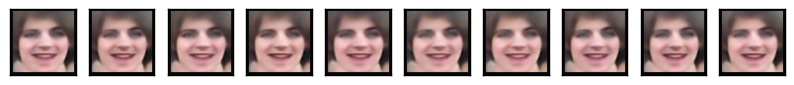

Iteration : 432 Best score : 12.073141073


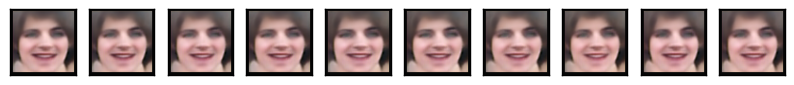

Iteration : 433 Best score : 12.0527757678


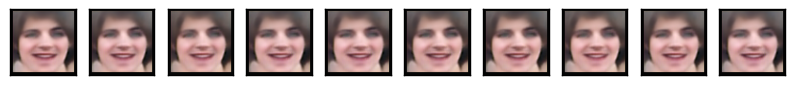

Iteration : 434 Best score : 12.0796246775


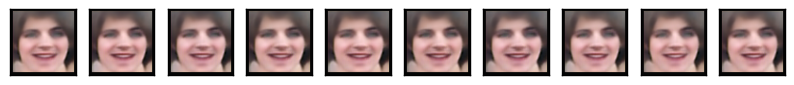

Iteration : 435 Best score : 12.0818124281


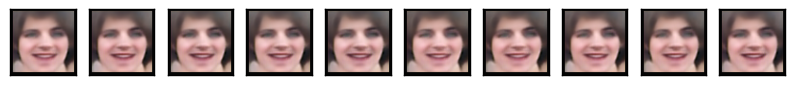

Iteration : 436 Best score : 12.0882683596


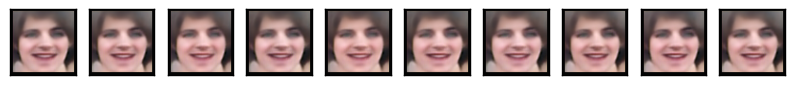

Iteration : 437 Best score : 12.0729297489


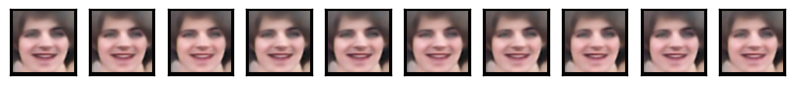

Iteration : 438 Best score : 12.0956828375


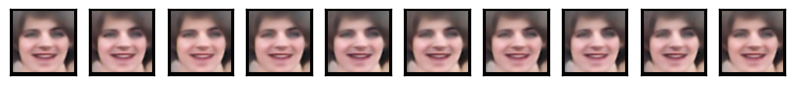

Iteration : 439 Best score : 12.1005176665


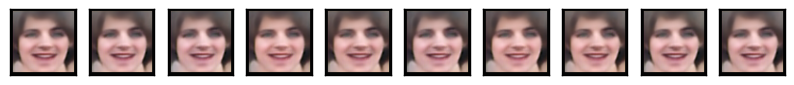

Iteration : 440 Best score : 12.094856128


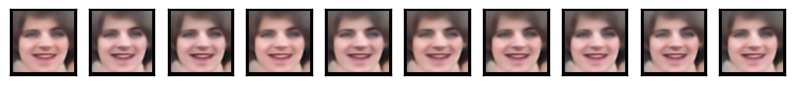

Iteration : 441 Best score : 12.1170884147


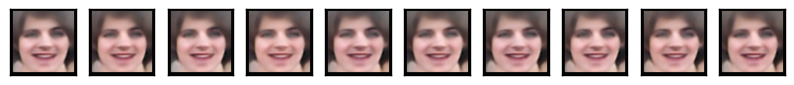

Iteration : 442 Best score : 12.1004065276


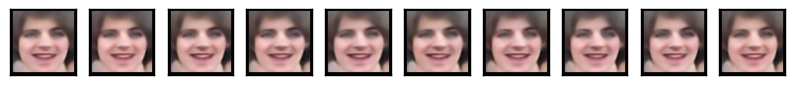

Iteration : 443 Best score : 12.1138312522


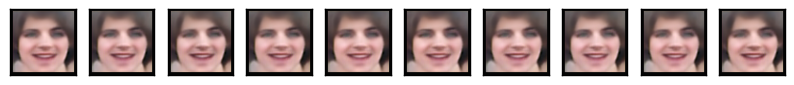

Iteration : 444 Best score : 12.0319811289


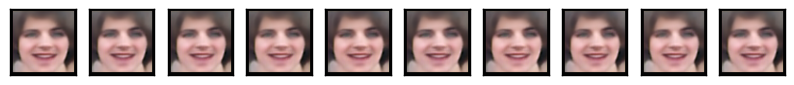

Iteration : 445 Best score : 12.0510841148


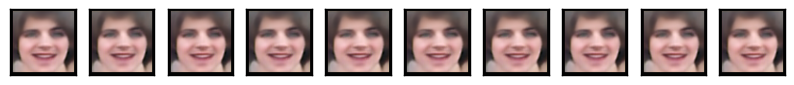

Iteration : 446 Best score : 12.0727640852


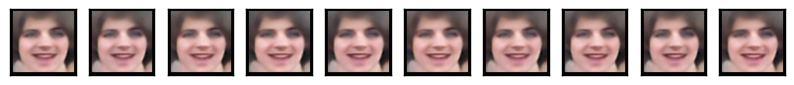

Iteration : 447 Best score : 12.0693418546


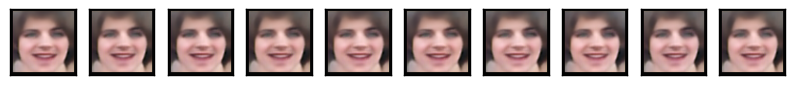

Iteration : 448 Best score : 12.0249463741


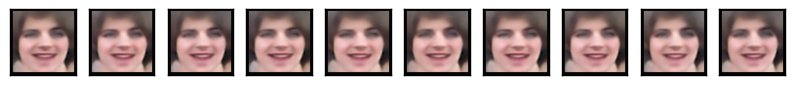

Iteration : 449 Best score : 12.043888954


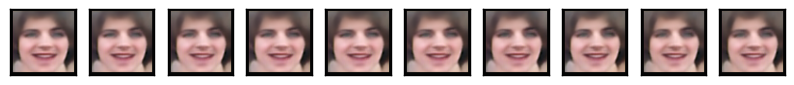

Iteration : 450 Best score : 12.0499040978


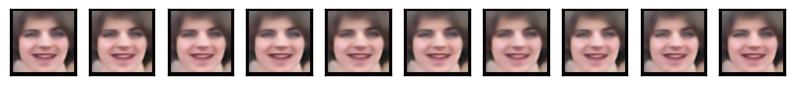

Iteration : 451 Best score : 12.0522394153


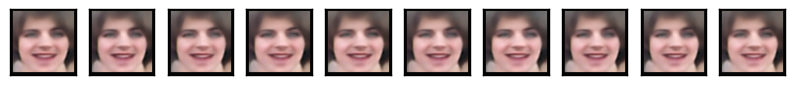

Iteration : 452 Best score : 12.0240290501


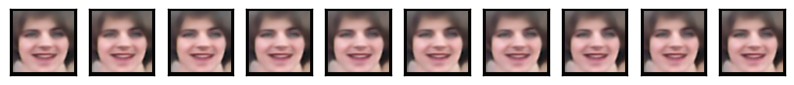

Iteration : 453 Best score : 12.0200863819


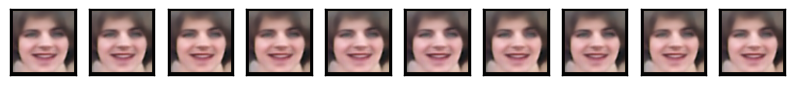

Iteration : 454 Best score : 12.0560808057


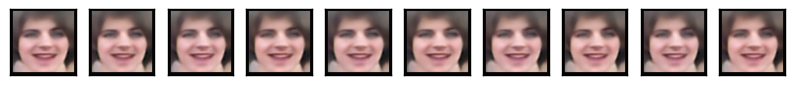

Iteration : 455 Best score : 12.0312369993


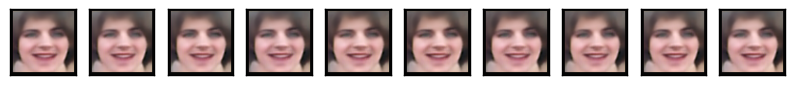

Iteration : 456 Best score : 12.0806397995


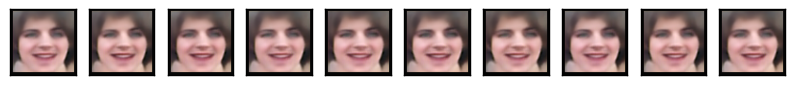

Iteration : 457 Best score : 12.0578974105


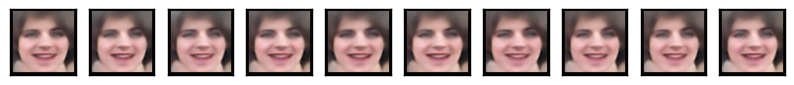

Iteration : 458 Best score : 12.0660746753


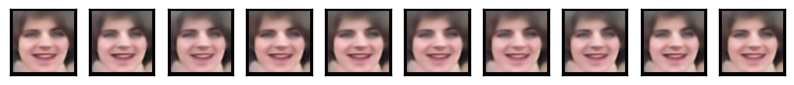

Iteration : 459 Best score : 12.0634601442


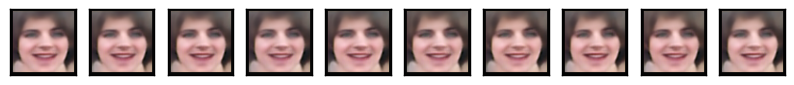

Iteration : 460 Best score : 12.0471238063


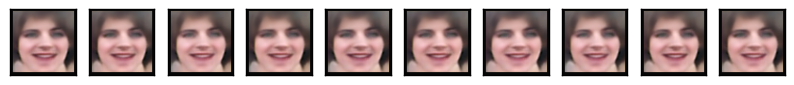

Iteration : 461 Best score : 12.0555810962


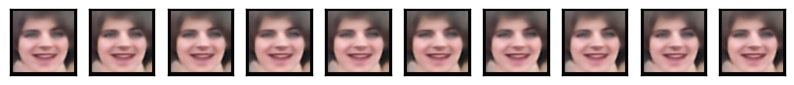

Iteration : 462 Best score : 12.012269426


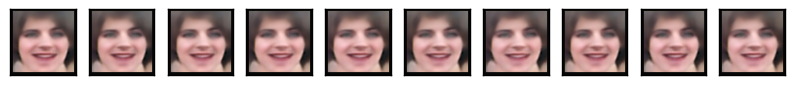

Iteration : 463 Best score : 12.0923382779


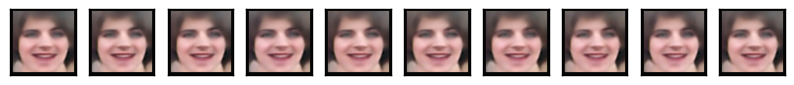

Iteration : 464 Best score : 12.0795849591


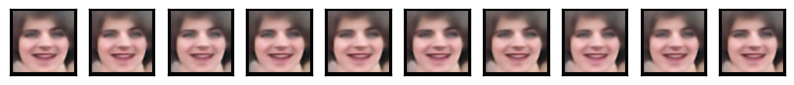

Iteration : 465 Best score : 12.0654130504


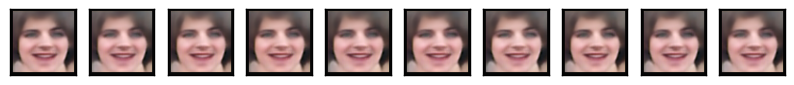

Iteration : 466 Best score : 12.1508294553


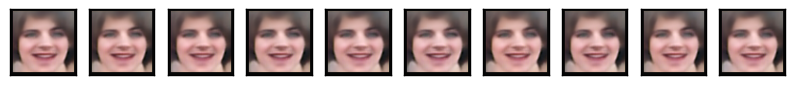

Iteration : 467 Best score : 12.0776709307


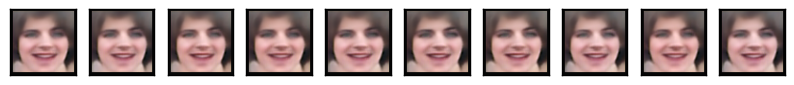

Iteration : 468 Best score : 12.096051285


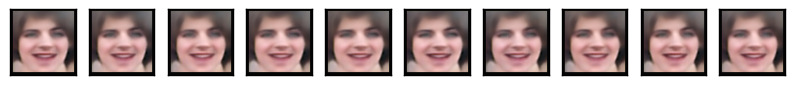

Iteration : 469 Best score : 12.0945599104


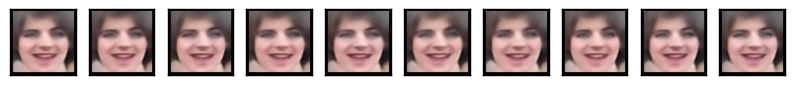

Iteration : 470 Best score : 12.1014674001


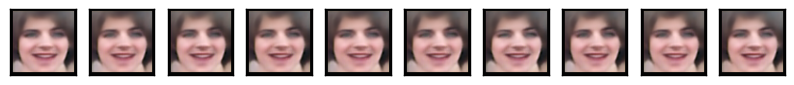

Iteration : 471 Best score : 12.0870188027


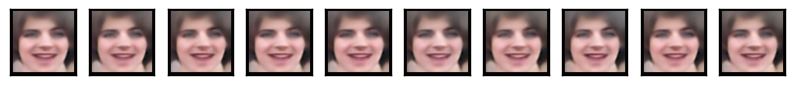

Iteration : 472 Best score : 12.0948449516


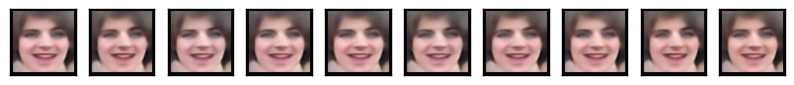

Iteration : 473 Best score : 12.0746361998


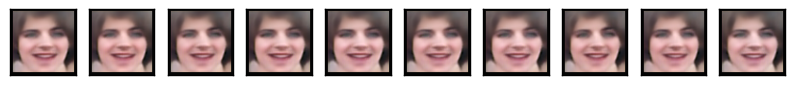

Iteration : 474 Best score : 12.0905776154


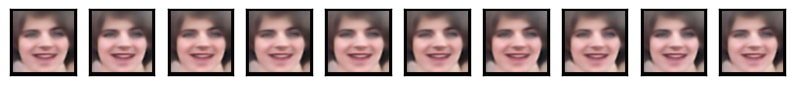

Iteration : 475 Best score : 12.090420463


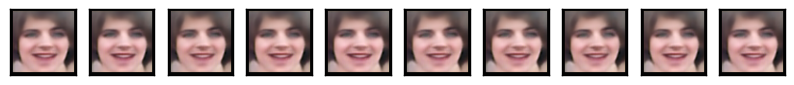

Iteration : 476 Best score : 12.066862301


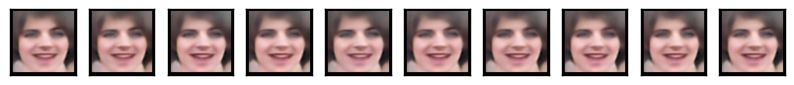

Iteration : 477 Best score : 12.0738432621


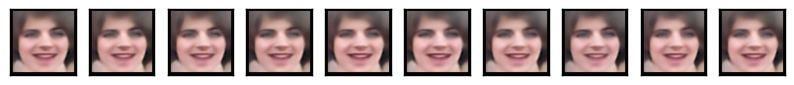

Iteration : 478 Best score : 12.0114983293


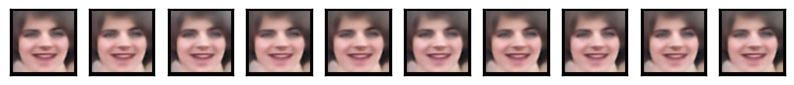

Iteration : 479 Best score : 12.049208287


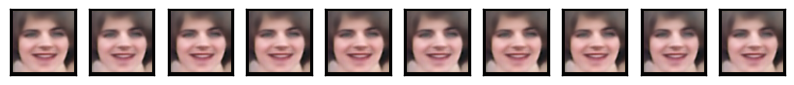

Iteration : 480 Best score : 12.0005234026


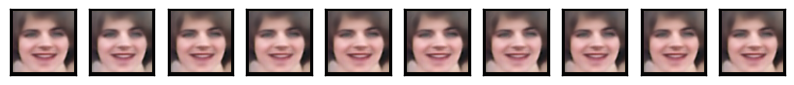

Iteration : 481 Best score : 12.0383933655


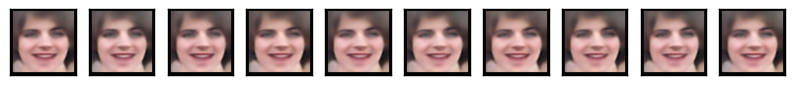

Iteration : 482 Best score : 12.0369022321


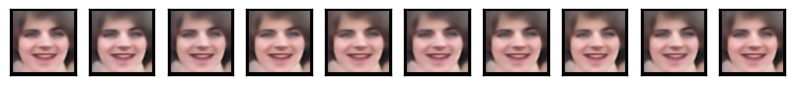

Iteration : 483 Best score : 12.0775060507


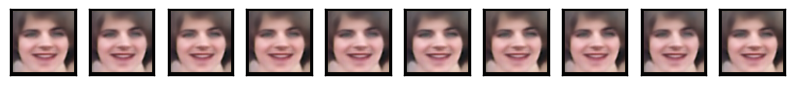

Iteration : 484 Best score : 12.0621387627


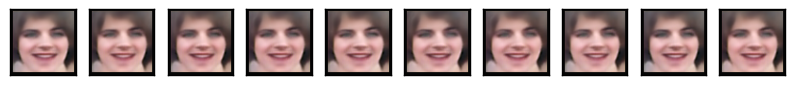

Iteration : 485 Best score : 12.0227445824


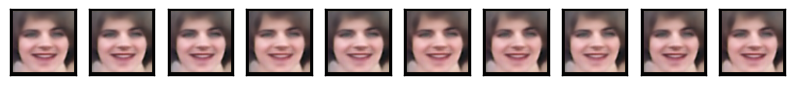

Iteration : 486 Best score : 12.0644860395


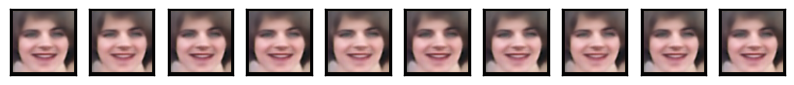

Iteration : 487 Best score : 12.0783472227


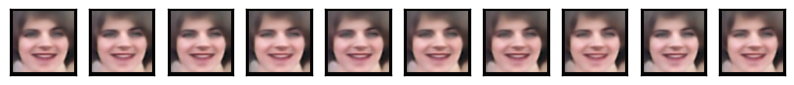

Iteration : 488 Best score : 12.0269519605


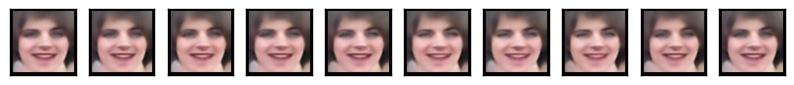

Iteration : 489 Best score : 12.0694679638


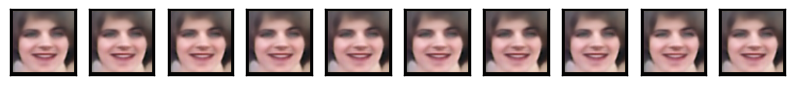

Iteration : 490 Best score : 12.055976236


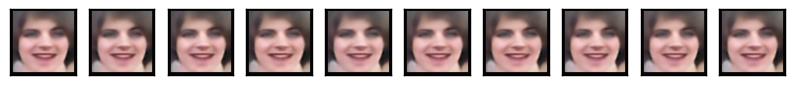

Iteration : 491 Best score : 12.0571200986


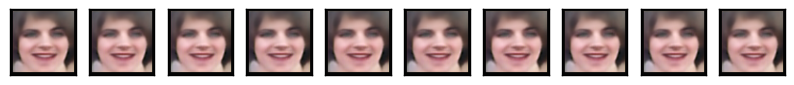

Iteration : 492 Best score : 12.0745506613


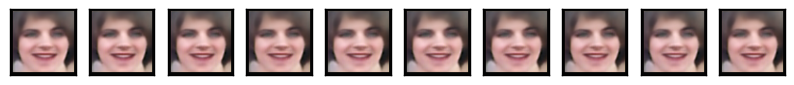

Iteration : 493 Best score : 12.0577582348


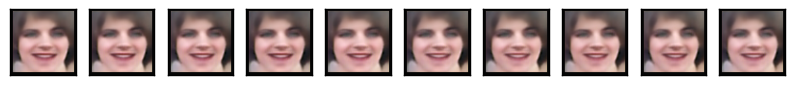

Iteration : 494 Best score : 12.0199659341


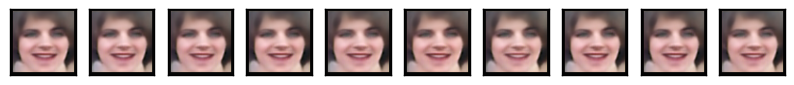

Iteration : 495 Best score : 12.0026520615


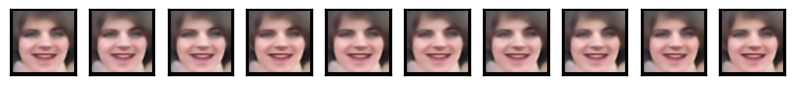

Iteration : 496 Best score : 12.0044214696


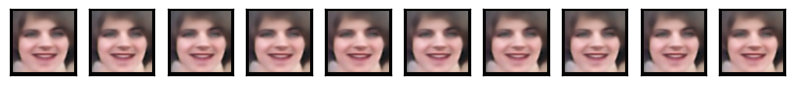

Iteration : 497 Best score : 11.9606515318


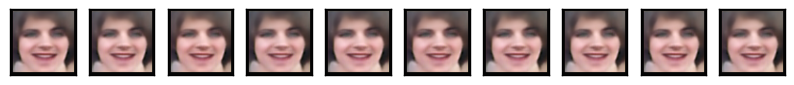

Iteration : 498 Best score : 11.9831728145


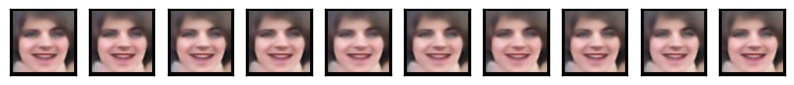

Iteration : 499 Best score : 12.0420584811


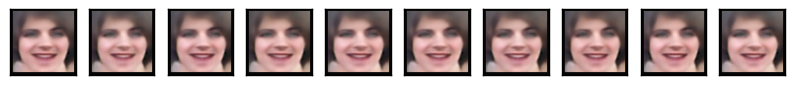

In [17]:
generationMins = []
generationLatentSpace = []

maxIter = 500
currIter = 0
generationSize = 65
top = 10

latentSpace = np.zeros((generationSize, latentVarSize), np.float32)
for i in range(generationSize):
    latentSpace[i, :] = initialGenes + np.random.uniform(-1., 1., (100,)) * 5

while currIter < maxIter:

    # Generate Generation
    with sess.as_default():
        # Load checkpoint
        vae_checkpoint = os.path.expanduser('/home/aprml6/kush/ai/facenet/vae/model.ckpt-50000')
        saver.restore(sess, vae_checkpoint)
        recon = sess.run(reconstructed, feed_dict={latent_var : latentSpace})

    scores = []
    
    # Select top 10 solutions based on evaluation function
    for i in range(generationSize):
        img = facenet.put_images_on_grid(recon[i : i + 1], shape=(1, 1))
        misc.imsave('temp.png', img)
        img = misc.imread('temp.png')
        scores.append(evaluateFitness(img))
       
    topTenIndices = np.array(scores).argsort()[: top]
    generationMins.append(scores[topTenIndices[0]])
    generationLatentSpace.append(latentSpace[topTenIndices[0] : topTenIndices[0] + 1].flatten().tolist())
    
    print ("Iteration : " + str(currIter) + " Best score : " + str(scores[topTenIndices[0]]))
    for i in range(top):
        img = facenet.put_images_on_grid(recon[topTenIndices[i] : topTenIndices[i] + 1], shape=(1, 1))
        misc.imsave('temp.png', img)
        img = misc.imread('temp.png')
        plt.subplot(1, top, i + 1)
        plt.gca().xaxis.set_visible(False)
        plt.gca().yaxis.set_visible(False)
        plt.imshow(img)
    plt.show()
    
    newLatentSpace = []
    
    for ind in topTenIndices:
        newLatentSpace.append(latentSpace[ind])
    
    for i in range(10):
        for j in range(i, 10):
            newLatentSpace.append(crossover(newLatentSpace[i], newLatentSpace[j]))
    
    for i in range(10, 65):
        if np.random.uniform() > 0.25:
            newLatentSpace[i] = mutate(newLatentSpace[i])
    
    newLatentSpace = np.array(newLatentSpace)
    
    for i in range(65):
        newLatentSpace[i] = localSearch(newLatentSpace[i])

    latentSpace = np.array(newLatentSpace)

    currIter += 1

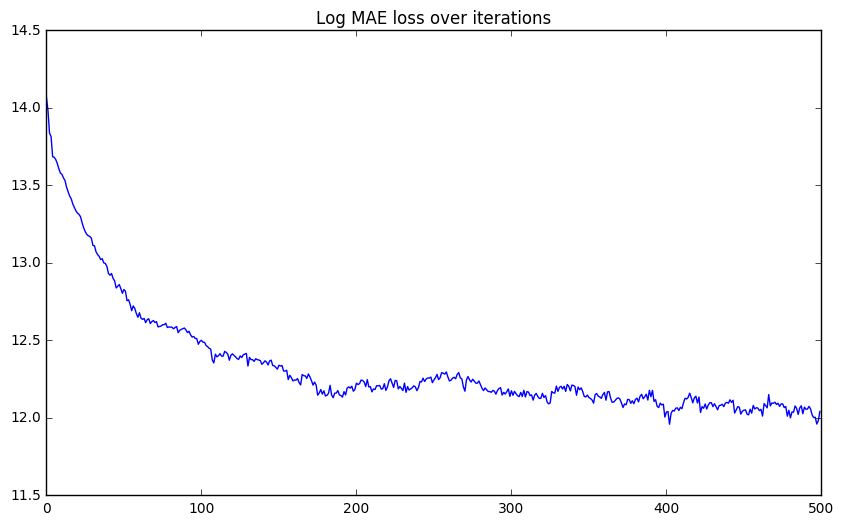

In [18]:
plt.plot([i for i in range(len(generationMins))], generationMins)
plt.title('Log MAE loss over iterations')

In [19]:
np.array(generationLatentSpace).shape

(500, 100)

In [20]:
np.argmin(generationMins)

402

# Save best image

In [21]:
with sess.as_default():
    # Load checkpoint
    vae_checkpoint = os.path.expanduser('/home/aprml6/kush/ai/facenet/vae/model.ckpt-50000')
    saver.restore(sess, vae_checkpoint)
    recon = sess.run(reconstructed, feed_dict={latent_var : generationLatentSpace[np.argmin(generationMins) : np.argmin(generationMins) + 1]})

img = facenet.put_images_on_grid(recon[0 : 1], shape=(1, 1))
misc.imsave('/home/aprml6/kush/ai/facenet/vae/best.png', img)

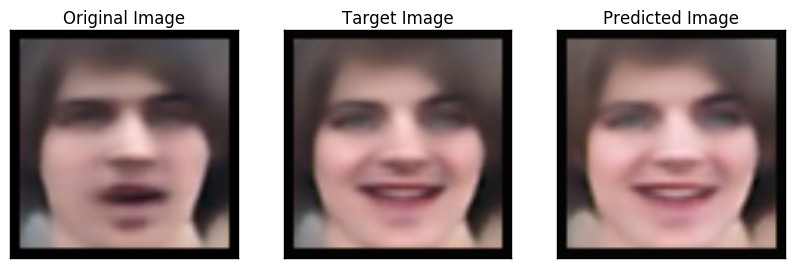

In [22]:
originalImage = misc.imread('/home/aprml6/kush/ai/facenet/vae/original.png')
plt.subplot(1, 3, 1)
plt.gca().xaxis.set_visible(False)
plt.gca().yaxis.set_visible(False)
plt.imshow(originalImage)
plt.title('Original Image')

targetImage = misc.imread('/home/aprml6/kush/ai/facenet/vae/target.png')
plt.subplot(1, 3, 2)
plt.gca().xaxis.set_visible(False)
plt.gca().yaxis.set_visible(False)
plt.imshow(targetImage)
plt.title('Target Image')

bestImage = misc.imread('/home/aprml6/kush/ai/facenet/vae/best.png')
plt.subplot(1, 3, 3)
plt.gca().xaxis.set_visible(False)
plt.gca().yaxis.set_visible(False)
plt.imshow(bestImage)
plt.title('Predicted Image')